In [1]:
%load_ext autoreload
import scanpy as sc

In [2]:
sc.set_figure_params(figsize=(5,5)) # no blurry figures allowed
sc.settings.verbosity = 4  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis', frameon=True)
# sc.settings.set_figure_params(dpi=80, color_map='coolwarm')

In [3]:
%autoreload 2 

import sys
sys.path.append('./code/')
from init_global_vars import *
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
PATH_TO_ADATA = './adatas/Foxp3Degrad-Multi-Organ.h5ad'
adata_organs = sc.read_h5ad(PATH_TO_ADATA)

In [5]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

#### Filter TCR/BCR, pseudogenes, and non-annotated genes.

In [6]:
tcr_bcr_genes = ['Igha', 'Igkc', 'Jchain', 
                 'Trav5-1', 'Trav14d-3-dv8', 'Trav16n', 'Trav14n-3',
                 'Trav7-5', 'Trav13-1', 'Trav14-1', 'Trav4-3', 'Trav12-2', 'Trav14-2',
                 'Trav3-3', 'Trav4-4-dv10', 'Trav5-4', 'Trav6-7-dv9', 'Trav16',
                 'Trav14-3', 'Trav21-dv12', 'Ighd', 'Ighm', 
                 'Trbv1', 'Trbv2', 'Trbv3', 'Trbv12-1', 'Trbv13-1', 'Trbv12-2',
                 'Trbv13-2', 'Trbv13-3', 'Trbv15', 'Trbv16', 'Trbv19', 'Trbv20',
                 'Trbv26', 'Trbv31', 'Ptcra', 'Trdc', 'Iglc1', 'Trgc4',
                 'Trbv5', 'Trbv14', 'Trbv17', 'Trbv23', 'Trbv29', 'Trbv30', 'Trbc1',
                 'Trbc2', 'Trbv4', 'Trgc1', 'Trgc2'
            ]

print('Removing: ', adata_organs.var.index[adata_organs.var.index.isin(tcr_bcr_genes)].shape, ' TCR/BCR genes')
# print('Removing: ', adata_organs.var.index[adata_organs.var.index.str.contains("-ps1")].shape, ' "-ps1" genes')
# print('Removing: ', adata_organs.var.index[adata_organs.var.index.str.contains("Gm")].shape, ' "Gm" genes')

adata_organs = adata_organs[:, ~adata_organs.var.index.isin(tcr_bcr_genes)]

Removing:  (33,)  TCR/BCR genes


### Geneset Scoring function

In [7]:
from anthony_config import load_joris_rna
def score_genesets_on_adata(adata):
    dfdict, lfc_df, pval_df, _, _, _ = load_joris_rna()
    pval_df_all = pd.read_csv('./paper/tables/pval_df_all.csv', index_col = 0)
    lfc_df_all = pd.read_csv('./paper/tables/lfc_df_all.csv', index_col = 0)
    
    lfc_df_all = lfc_df_all.drop("Gt(ROSA)26Sor")
    pval_df_all = pval_df_all.drop("Gt(ROSA)26Sor")
        
    up_aTreg, up_rTreg = get_differential_sites(dfdict['activated_Treg_vs_resting_Treg'], 1e-4, .25)
    up_aTcon, down_aTcon = get_differential_sites(dfdict['activated_Tcon_vs_activated_Treg'], 1e-4, .55)
    up_rTcon, down_rTcon = get_differential_sites(dfdict['resting_Tcon_vs_resting_Treg'], 1e-4, .55)
    up_aKIKO, down_aKIKO = get_differential_sites(dfdict['activated_Foxp3_GFPKO_vs_activated_Treg_GFP_DTR_WT'], 1e-4, .25)
    up_rKIKO, down_rKIKO = get_differential_sites(dfdict['resting_Foxp3_GFPKO_vs_resting_Treg_GFP_DTR_WT'], 1e-4, .25)    

    up_r_bulk, down_r_bulk = get_differential_sites_separate_df(lfc_df_all, pval_df_all, 'wei_SpleenLN.TIR1.Resting_vs_SpleenLN.WT.Resting', .05, 0)
    up_a_bulk, down_a_bulk = get_differential_sites_separate_df(lfc_df_all, pval_df_all, 'wei_SpleenLN.TIR1.Activated_vs_SpleenLN.WT.Activated', .05, 0)
    up_t_bulk, down_t_bulk = get_differential_sites_separate_df(lfc_df_all, pval_df_all, 'wei_Thymus.TIR1.Developing_vs_Thymus.WT.Developing', .1, 0)
    up_rd7_tir1, down_rd7_tir1 = get_differential_sites_separate_df(lfc_df_all, pval_df_all, 'sc_rest_D7_tir1_vs_D7_wt', .1, 0)
    up_ad7_tir1, down_ad7_tir1 = get_differential_sites_separate_df(lfc_df_all, pval_df_all, 'sc_active_D7_tir1_vs_D7_wt', .1, 0)
    
    sc.tl.score_genes(adata, up_aTcon, score_name='up_aTcon')
    sc.tl.score_genes(adata, down_aTcon, score_name='down_aTcon')
    sc.tl.score_genes(adata, up_rTcon, score_name='up_rTcon')
    sc.tl.score_genes(adata, down_rTcon, score_name='down_rTcon')
    
    sc.tl.score_genes(adata, up_aTreg, score_name='up_aTreg')
    sc.tl.score_genes(adata, up_rTreg, score_name='up_rTreg')

#### Filter cells

In [8]:
adata_organs.layers['counts'] = np.asarray(adata_organs.layers['counts'].todense())
adata_organs.obs['counts_per_cell'] = np.ravel(adata_organs.layers['counts'].sum(axis=1))
adata_organs.var['counts'] = np.ravel(adata_organs.layers['counts'].mean(axis=0))

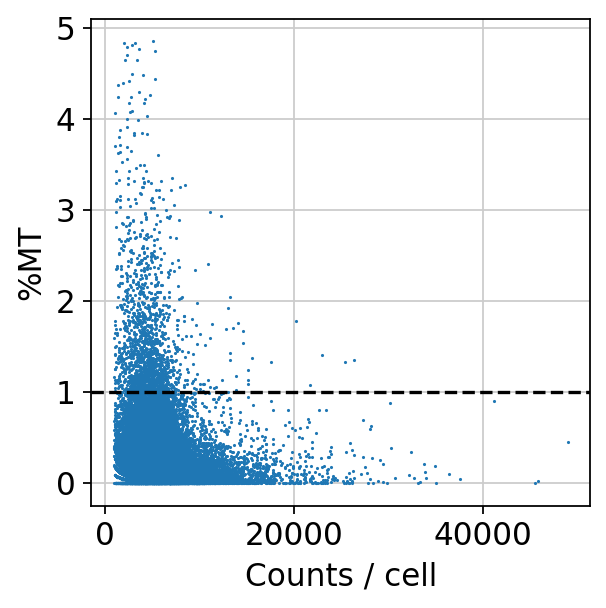

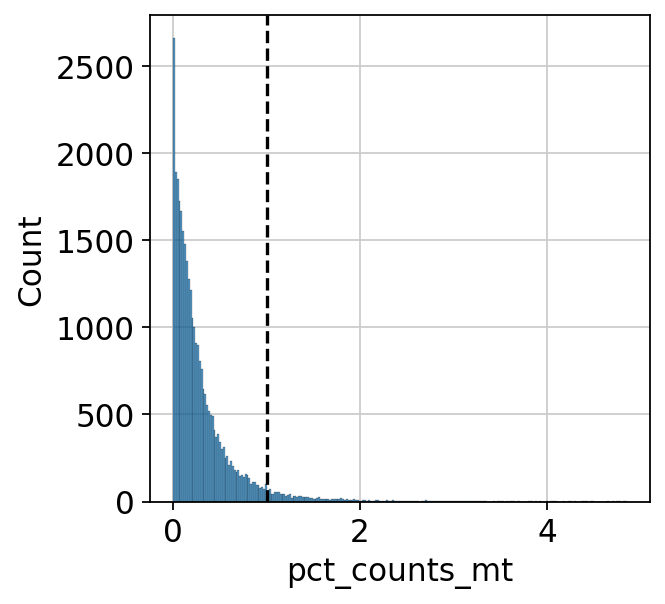

In [9]:
plt.scatter(adata_organs.obs['counts_per_cell'], adata_organs.obs['pct_counts_mt'], s = 2, linewidth=0)
plt.xlabel("Counts / cell")
plt.ylabel("%MT")
plt.axhline(1, color='black', linestyle='--')

plt.figure()
sns.histplot(adata_organs.obs['pct_counts_mt'])
plt.axvline(1, color='black', linestyle='--')

adata_organs = adata_organs[adata_organs.obs['pct_counts_mt'] < 1]
adata_organs = adata_organs[:, ~adata_organs.var.index.str.contains("mt-")]

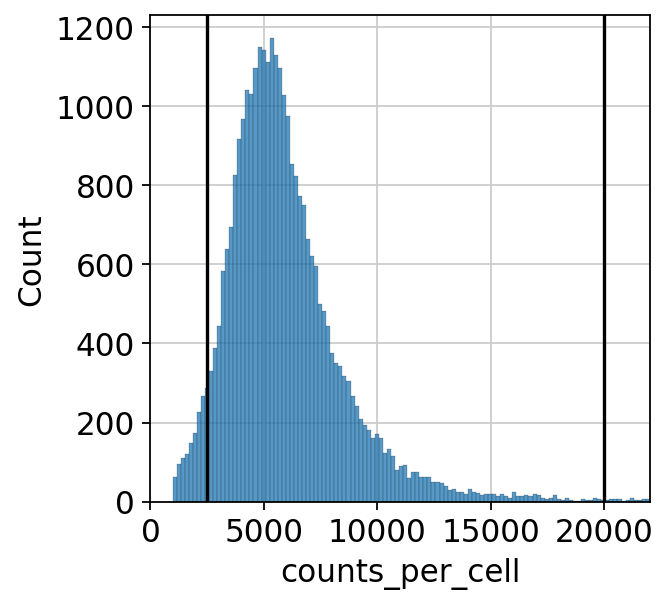

In [10]:
sns.histplot(adata_organs.obs['counts_per_cell'])
plt.xlim([0, 22_000])
plt.axvline(2500, color='black')
plt.axvline(20_000, color='black')
adata_organs = adata_organs[(adata_organs.obs['counts_per_cell'] > 2500) & (adata_organs.obs['counts_per_cell'] <  20_000)]

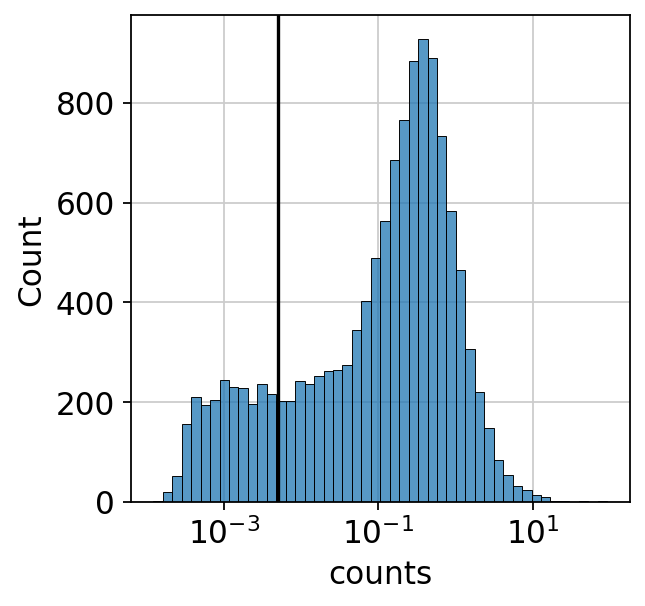

In [11]:
sns.histplot(adata_organs.var['counts'], log_scale=True)
plt.axvline(.005, color='black')
adata_organs = adata_organs[:, (adata_organs.var['counts'] > .005)]

In [12]:
from revision_process_adata import normalize_adata
normalize_adata(adata_organs)

/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
    ... clipping at max_value 10


In [13]:
from aux_functions_scRNA import *

n_pcs = 100
sc.tl.pca(adata_organs, n_comps=n_pcs, svd_solver='arpack')
# we like cosine similarity more so than Euclidean (better silhouettes once clustering)
sc.pp.neighbors(adata_organs, n_neighbors=30, n_pcs=n_pcs, use_rep='X_pca', metric="cosine")
sc.tl.leiden(adata_organs, resolution = 1)
sc.tl.umap(adata_organs)

agg = aggregate_adata_by_obs_column(adata_organs, key='leiden', layer='lognorm')
score_genesets_on_adata(adata_organs)

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:08)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)
computing neighbors
        initialized `.distances` `.connectivities` 
    computing neighbors


/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Genomics/argo/users/g

    computed neighbors (0:00:49)
    computed connectivities (0:00:05)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:55)
running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:09)
computing UMAP


  0%|          | 0/200 [00:00<?, ?it/s]

    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:27)
computing score 'up_aTcon'
    finished: added
    'up_aTcon', score of gene set (adata.obs).
    1159 total control genes are used. (0:00:01)
computing score 'down_aTcon'
    finished: added
    'down_aTcon', score of gene set (adata.obs).
    1083 total control genes are used. (0:00:01)
computing score 'up_rTcon'
    finished: added
    'up_rTcon', score of gene set (adata.obs).
    1188 total control genes are used. (0:00:00)
computing score 'down_rTcon'
    finished: added
    'down_rTcon', score of gene set (adata.obs).
    1157 total control genes are used. (0:00:00)
computing score 'up_aTreg'
    finished: added
    'up_aTreg', score of gene set (adata.obs).
    1147 total control genes are used. (0:00:01)
computing score 'up_rTreg'
    finished: added
    'up_rTreg', score of gene set (adata.obs).
    1178 total control genes are used. (0:00:00)


In [14]:
from aux_functions_scRNA import *
tissue_specific_adatas = {}
for tissue in adata_organs.obs['tissue'].unique():
    subadata = adata_organs[adata_organs.obs['tissue'] == tissue].copy()
    subadata.layers['counts'] = np.asarray(subadata.layers['counts']).copy()
    subadata.var['counts'] = np.ravel(subadata.layers['counts'].mean(axis=0))
    subadata = subadata[:, (subadata.var['counts'] > .005)].copy()

    normalize_adata(subadata)
    
    subadata_no_subset = adata_organs[adata_organs.obs['tissue'] == tissue].copy()
    
    n_pcs = 100
    sc.tl.pca(subadata, n_comps=n_pcs, svd_solver='arpack')
    # we like cosine similarity more so than Euclidean (better silhouettes once clustering)
    sc.pp.neighbors(subadata, n_neighbors=30, n_pcs=n_pcs, use_rep='X_pca', metric="cosine")
    sc.tl.leiden(subadata, resolution = 1)
    sc.tl.leiden(subadata, resolution = 2, key_added='leiden_res=2')
    sc.tl.leiden(subadata, resolution = 0.5, key_added='leiden_res=0.5')
    sc.tl.leiden(subadata, resolution = 0.25, key_added='leiden_res=0.25')
    sc.tl.umap(subadata)
    # score_genesets_on_adata(subadata)
    tissue_specific_adatas[tissue] = subadata
    score_genesets_on_adata(adata_organs)
    print("Done with", tissue)

normalizing counts per cell
    finished (0:00:00)
    ... clipping at max_value 10
computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:02)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)
computing neighbors
        initialized `.distances` `.connectivities` 
    computing neighbors
    computed neighbors (0:00:00)
    computed connectivities (0:00:01)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
running Leiden clustering
    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)
running Leiden clustering
    finished: found 21 clusters and added
    'leiden_res=2', the cluster labels (adata.obs, categorical

  0%|          | 0/500 [00:00<?, ?it/s]

    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:19)
computing score 'up_aTcon'
    finished: added
    'up_aTcon', score of gene set (adata.obs).
    1159 total control genes are used. (0:00:01)
computing score 'down_aTcon'
    finished: added
    'down_aTcon', score of gene set (adata.obs).
    1083 total control genes are used. (0:00:01)
computing score 'up_rTcon'
    finished: added
    'up_rTcon', score of gene set (adata.obs).
    1188 total control genes are used. (0:00:00)
computing score 'down_rTcon'
    finished: added
    'down_rTcon', score of gene set (adata.obs).
    1157 total control genes are used. (0:00:01)
computing score 'up_aTreg'
    finished: added
    'up_aTreg', score of gene set (adata.obs).
    1147 total control genes are used. (0:00:01)
computing score 'up_rTreg'
    finished: added
    'up_rTreg', score of gene set (adata.obs).
    1178 total control genes are used. (0:00:00)
Done with LILP
normalizing counts per cell
    finished (0:0

  0%|          | 0/500 [00:00<?, ?it/s]

    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:19)
computing score 'up_aTcon'
    finished: added
    'up_aTcon', score of gene set (adata.obs).
    1159 total control genes are used. (0:00:01)
computing score 'down_aTcon'
    finished: added
    'down_aTcon', score of gene set (adata.obs).
    1083 total control genes are used. (0:00:01)
computing score 'up_rTcon'
    finished: added
    'up_rTcon', score of gene set (adata.obs).
    1188 total control genes are used. (0:00:00)
computing score 'down_rTcon'
    finished: added
    'down_rTcon', score of gene set (adata.obs).
    1157 total control genes are used. (0:00:01)
computing score 'up_aTreg'
    finished: added
    'up_aTreg', score of gene set (adata.obs).
    1147 total control genes are used. (0:00:01)
computing score 'up_rTreg'
    finished: added
    'up_rTreg', score of gene set (adata.obs).
    1178 total control genes are used. (0:00:00)
Done with Lung
normalizing counts per cell
    finished (0:0

  0%|          | 0/500 [00:00<?, ?it/s]

    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:16)
computing score 'up_aTcon'
    finished: added
    'up_aTcon', score of gene set (adata.obs).
    1159 total control genes are used. (0:00:01)
computing score 'down_aTcon'
    finished: added
    'down_aTcon', score of gene set (adata.obs).
    1083 total control genes are used. (0:00:01)
computing score 'up_rTcon'
    finished: added
    'up_rTcon', score of gene set (adata.obs).
    1188 total control genes are used. (0:00:00)
computing score 'down_rTcon'
    finished: added
    'down_rTcon', score of gene set (adata.obs).
    1157 total control genes are used. (0:00:00)
computing score 'up_aTreg'
    finished: added
    'up_aTreg', score of gene set (adata.obs).
    1147 total control genes are used. (0:00:01)
computing score 'up_rTreg'
    finished: added
    'up_rTreg', score of gene set (adata.obs).
    1178 total control genes are used. (0:00:00)
Done with SLO
normalizing counts per cell
    finished (0:00

  0%|          | 0/500 [00:00<?, ?it/s]

    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:13)
computing score 'up_aTcon'
    finished: added
    'up_aTcon', score of gene set (adata.obs).
    1159 total control genes are used. (0:00:01)
computing score 'down_aTcon'
    finished: added
    'down_aTcon', score of gene set (adata.obs).
    1083 total control genes are used. (0:00:01)
computing score 'up_rTcon'
    finished: added
    'up_rTcon', score of gene set (adata.obs).
    1188 total control genes are used. (0:00:01)
computing score 'down_rTcon'
    finished: added
    'down_rTcon', score of gene set (adata.obs).
    1157 total control genes are used. (0:00:01)
computing score 'up_aTreg'
    finished: added
    'up_aTreg', score of gene set (adata.obs).
    1147 total control genes are used. (0:00:01)
computing score 'up_rTreg'
    finished: added
    'up_rTreg', score of gene set (adata.obs).
    1178 total control genes are used. (0:00:00)
Done with Liver


In [15]:
# for tissue in tissue_specific_adatas:
#     tissue_specific_adatas[tissue].write_h5ad(f'./adatas/{tissue}.h5ad')

### Load to skip preprocessing

In [16]:
tissue_specific_adatas = {}
for tissue in ['Liver', 'Lung', 'LILP', 'SLO']:
    tissue_specific_adatas[tissue] = sc.read_h5ad(f'./adatas/{tissue}.h5ad')

### Plot leiden clusters

/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/ma

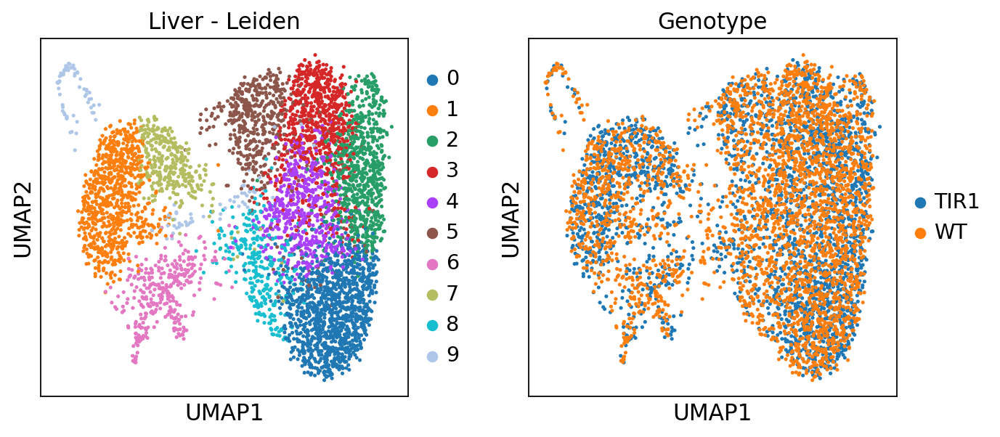

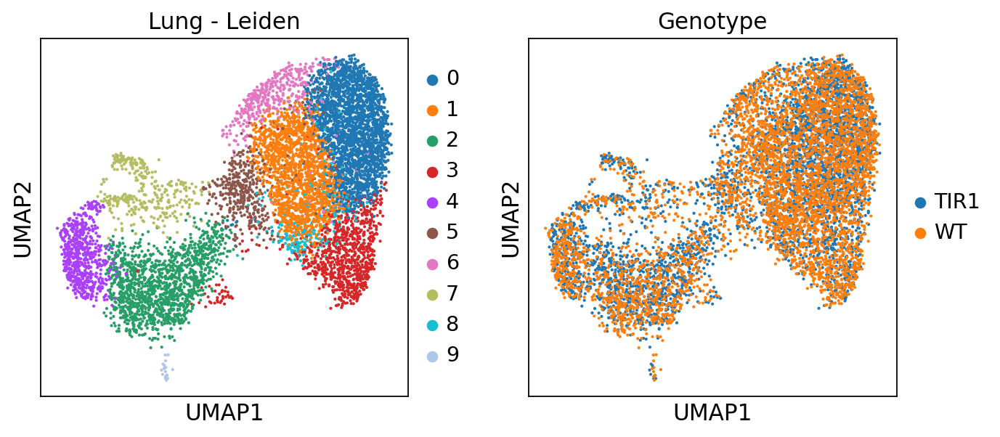

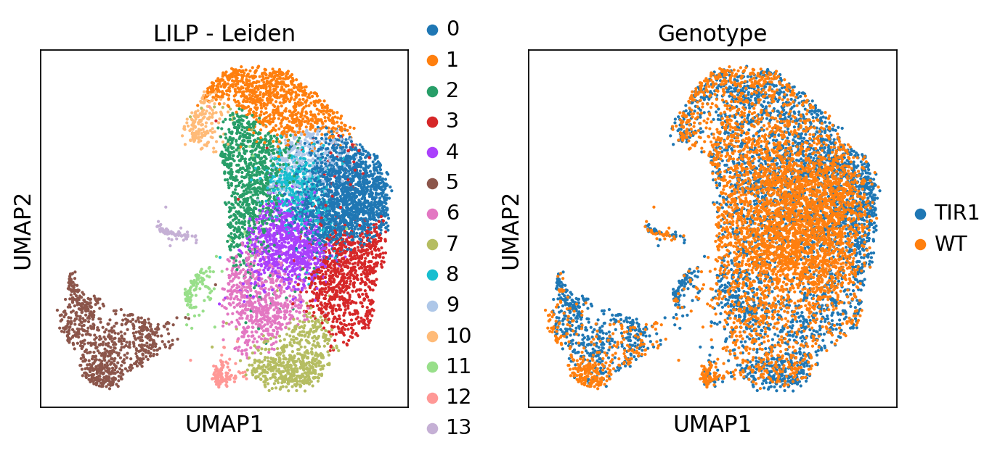

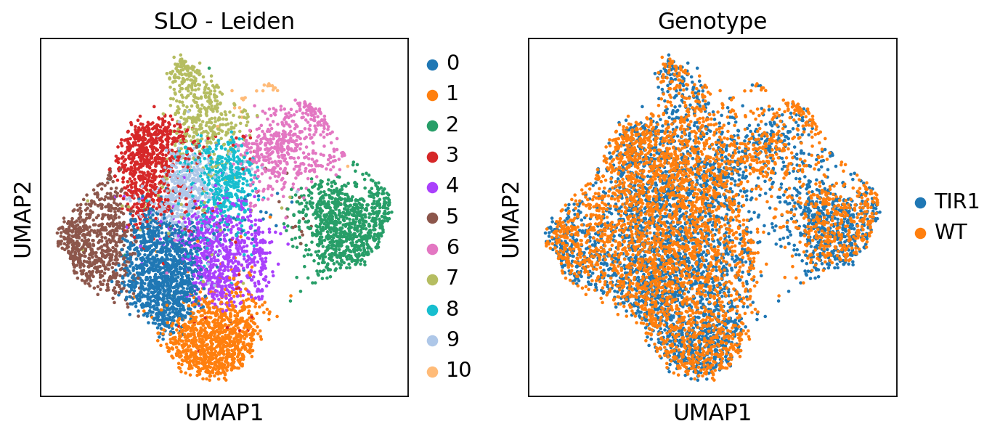

In [17]:
for tissue in tissue_specific_adatas:
    fig = sc.pl.umap(tissue_specific_adatas[tissue], color = ['leiden', 'sort_label'],
              title=[f'{tissue} - Leiden', 'Genotype'], return_fig=True)
    fig.savefig(f'./final_plots/revision_plots/multi_organ_scrna/{tissue}_leiden_umap.pdf', bbox_inches='tight')    

/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/ma

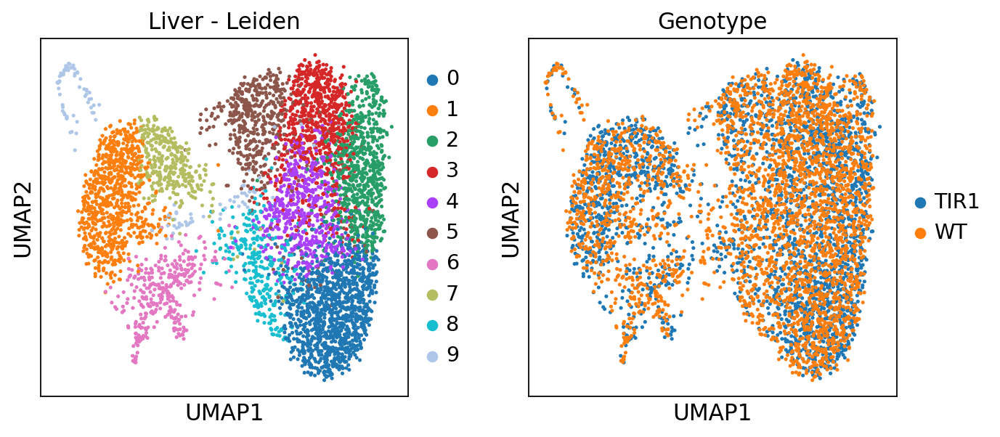

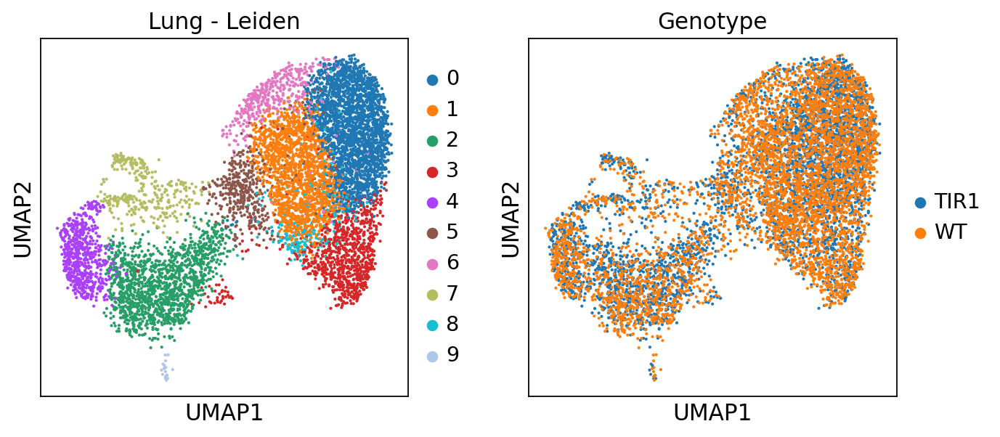

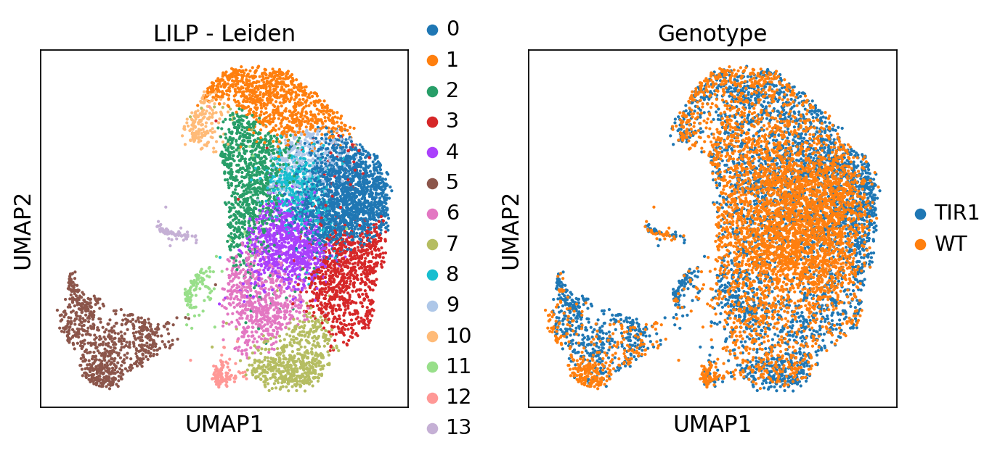

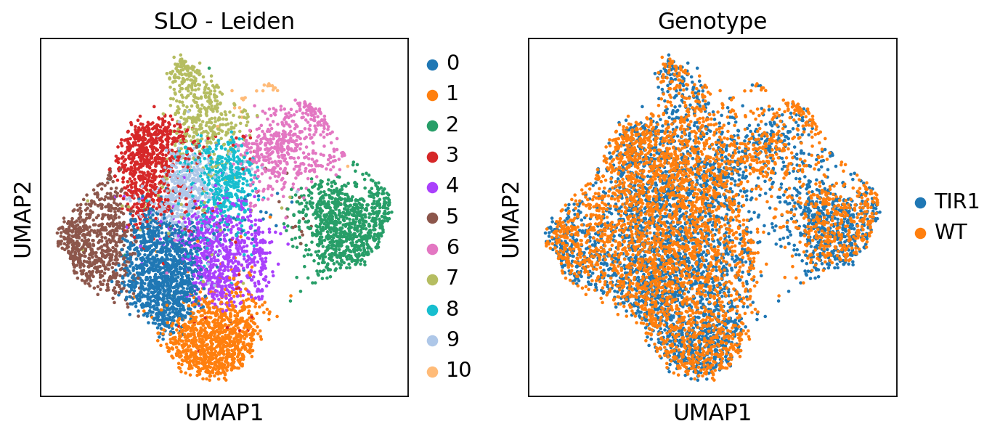

In [18]:
for tissue in tissue_specific_adatas:
    fig = sc.pl.umap(tissue_specific_adatas[tissue], color = ['leiden', 'sort_label'],
              title=[f'{tissue} - Leiden', 'Genotype'], return_fig=True)
    fig.savefig(f'./final_plots/revision_plots/multi_organ_scrna/{tissue}_leiden_umap.pdf', bbox_inches='tight')    

### Plot KDE plots

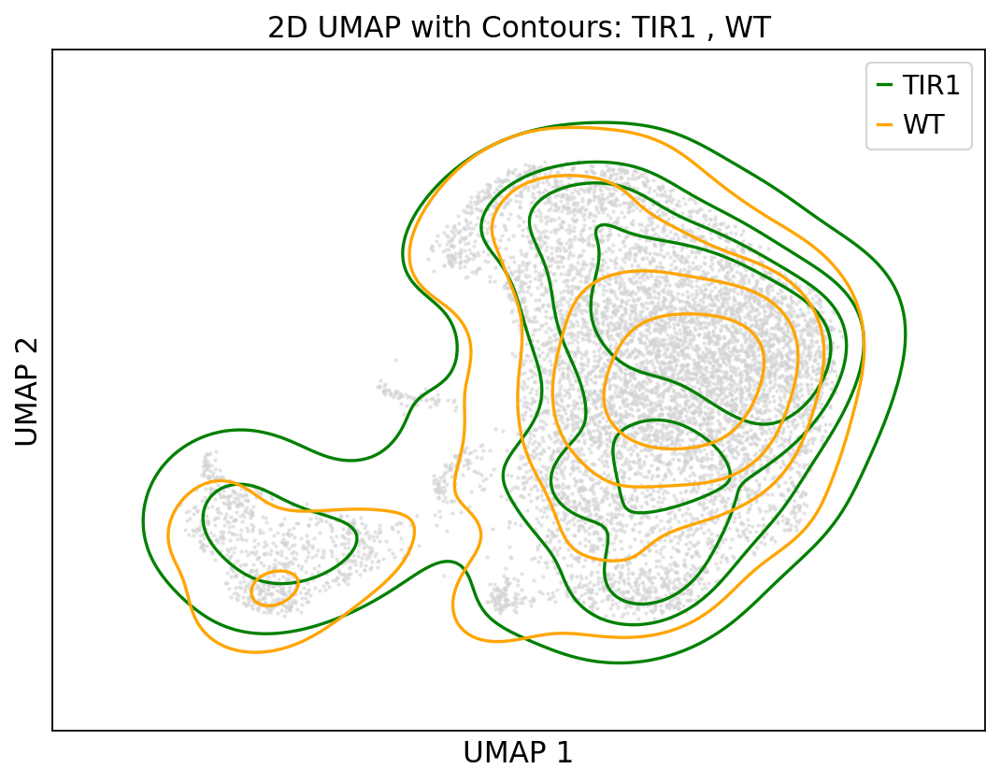

In [19]:
# Extract UMAP coordinates
columns = [['TIR1', 'WT']]
for col1, col2 in columns:
    umap_coords = tissue_specific_adatas['LILP'].obsm['X_umap']
    
    # Create a mask for the two groups
    mask_tir1 = tissue_specific_adatas['LILP'].obs['sort_label'] == col1
    mask_wt = tissue_specific_adatas['LILP'].obs['sort_label'] == col2
    
    scatter_idx = mask_tir1 | mask_wt
    
    # Get UMAP coordinates for each group
    umap_tir1 = umap_coords[mask_tir1]
    umap_wt = umap_coords[mask_wt]
    
    # Plot the UMAP with contours
    fig, ax = plt.subplots(figsize=(8, 6))
    plt.title(f'2D UMAP with Contours: {col1} , {col2}')
    
    # Scatter plot for all points in grey
    plt.scatter(umap_coords[scatter_idx, 0], umap_coords[scatter_idx, 1], c='lightgrey', alpha=0.5, s=1)
    
    # Contour plots
    sns.kdeplot(x = umap_tir1[:, 0], y = umap_tir1[:, 1], levels = 5, linewidths = 1.5, color = 'green', label = col1, bw_adjust = 1.2)
    sns.kdeplot(x = umap_wt[:, 0], y = umap_wt[:, 1], levels = 5, linewidths = 1.5, color = 'orange', label = col2, bw_adjust = 1.2)
    plt.plot([], [], label=col1, color='green',)
    plt.plot([], [], label=col2, color='orange',)
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    plt.legend()
    plt.xticks([])
    plt.yticks([])
    fig.savefig(f'./final_plots/revision_plots/multi_organ_scrna/contour_plot_LILP.pdf', bbox_inches='tight')

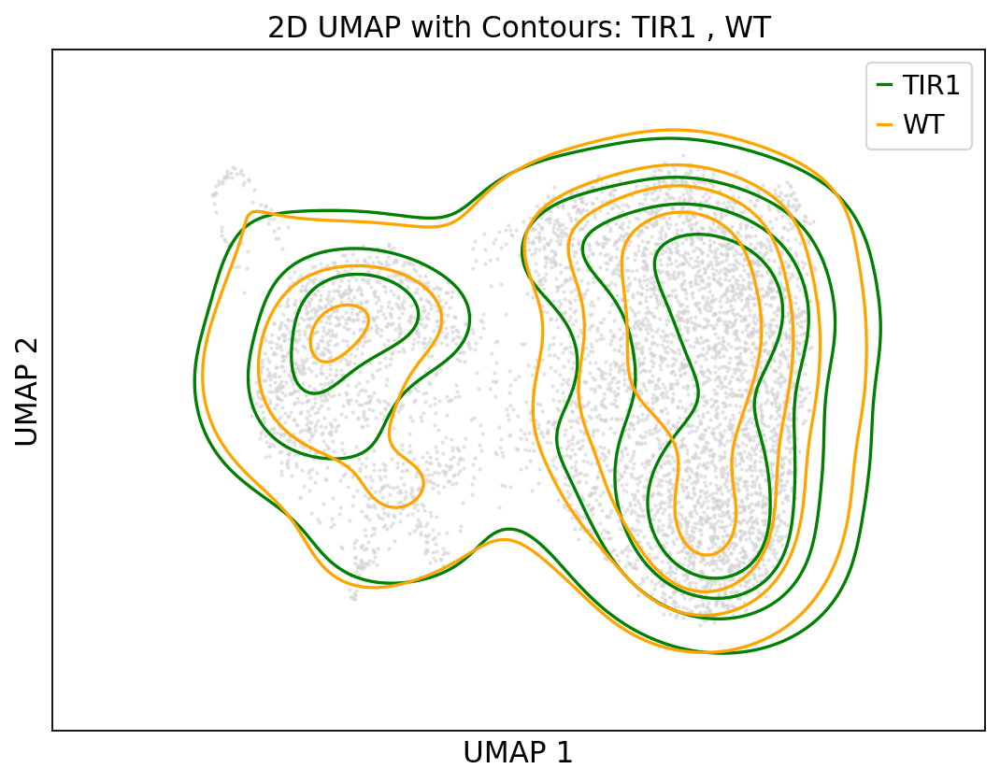

In [20]:
# Extract UMAP coordinates
columns = [
    ['TIR1', 'WT'],
]
for col1, col2 in columns:
    umap_coords = tissue_specific_adatas['Liver'].obsm['X_umap']
    
    # Create a mask for the two groups
    mask_tir1 = tissue_specific_adatas['Liver'].obs['sort_label'] == col1
    mask_wt = tissue_specific_adatas['Liver'].obs['sort_label'] == col2
    
    scatter_idx = mask_tir1 | mask_wt
    
    # Get UMAP coordinates for each group
    umap_tir1 = umap_coords[mask_tir1]
    umap_wt = umap_coords[mask_wt]
    
    # Plot the UMAP with contours
    fig, ax = plt.subplots(figsize=(8, 6))
    plt.title(f'2D UMAP with Contours: {col1} , {col2}')
    
    # Scatter plot for all points in grey
    plt.scatter(umap_coords[scatter_idx, 0], umap_coords[scatter_idx, 1], c='lightgrey', alpha=0.5, s=1)
    
    # Contour plots
    sns.kdeplot(x = umap_tir1[:, 0], y = umap_tir1[:, 1], levels = 5, linewidths = 1.5, color = 'green', label = col1, bw_adjust = 1.2)
    sns.kdeplot(x = umap_wt[:, 0], y = umap_wt[:, 1], levels = 5, linewidths = 1.5, color = 'orange', label = col2, bw_adjust = 1.2)
    plt.plot([], [], label=col1, color='green',)
    plt.plot([], [], label=col2, color='orange',)
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    plt.legend()
    plt.xticks([])
    plt.yticks([])
    fig.savefig(f'./final_plots/revision_plots/multi_organ_scrna/contour_plot_Liver.pdf', bbox_inches='tight')

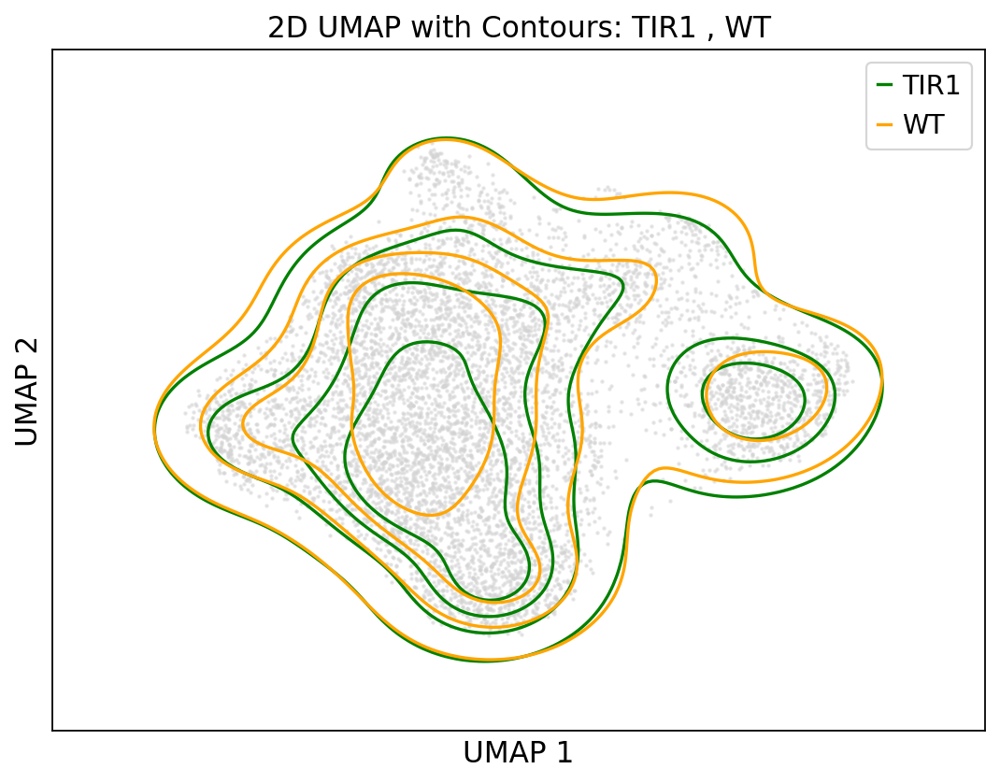

In [21]:
# Extract UMAP coordinates
columns = [
    ['TIR1', 'WT'],
]
for col1, col2 in columns:
    umap_coords = tissue_specific_adatas['SLO'].obsm['X_umap']
    
    # Create a mask for the two groups
    mask_tir1 = tissue_specific_adatas['SLO'].obs['sort_label'] == col1
    mask_wt = tissue_specific_adatas['SLO'].obs['sort_label'] == col2
    
    scatter_idx = mask_tir1 | mask_wt
    
    # Get UMAP coordinates for each group
    umap_tir1 = umap_coords[mask_tir1]
    umap_wt = umap_coords[mask_wt]
    
    # Plot the UMAP with contours
    fig, ax = plt.subplots(figsize=(8, 6))
    plt.title(f'2D UMAP with Contours: {col1} , {col2}')
    
    # Scatter plot for all points in grey
    plt.scatter(umap_coords[scatter_idx, 0], umap_coords[scatter_idx, 1], c='lightgrey', alpha=0.5, s=1)
    
    # Contour plots
    sns.kdeplot(x = umap_tir1[:, 0], y = umap_tir1[:, 1], levels = 5, linewidths = 1.5, color = 'green', label = col1, bw_adjust = 1.2)
    sns.kdeplot(x = umap_wt[:, 0], y = umap_wt[:, 1], levels = 5, linewidths = 1.5, color = 'orange', label = col2, bw_adjust = 1.2)
    plt.plot([], [], label=col1, color='green',)
    plt.plot([], [], label=col2, color='orange',)
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    plt.legend()
    plt.xticks([])
    plt.yticks([])
    fig.savefig(f'./final_plots/revision_plots/multi_organ_scrna/contour_plot_SLO.pdf', bbox_inches='tight')

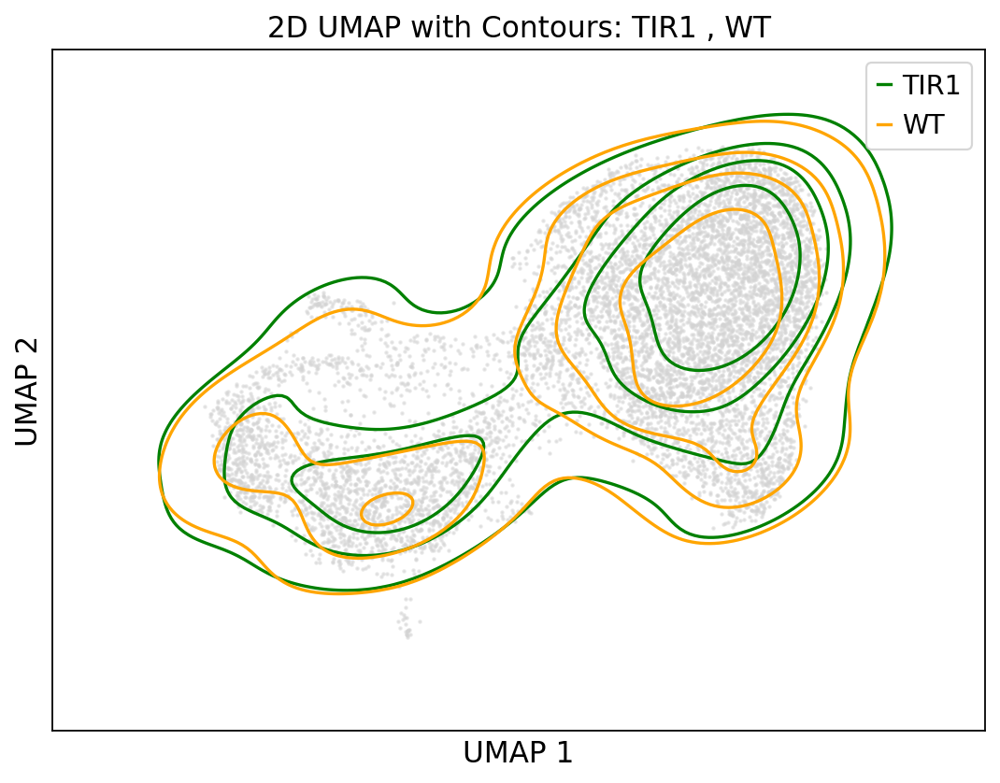

In [22]:
# Extract UMAP coordinates
columns = [
    ['TIR1', 'WT'],
]
for col1, col2 in columns:
    umap_coords = tissue_specific_adatas['Lung'].obsm['X_umap']
    
    # Create a mask for the two groups
    mask_tir1 = tissue_specific_adatas['Lung'].obs['sort_label'] == col1
    mask_wt = tissue_specific_adatas['Lung'].obs['sort_label'] == col2
    
    scatter_idx = mask_tir1 | mask_wt
    
    # Get UMAP coordinates for each group
    umap_tir1 = umap_coords[mask_tir1]
    umap_wt = umap_coords[mask_wt]
    
    # Plot the UMAP with contours
    fig, ax = plt.subplots(figsize=(8, 6))
    plt.title(f'2D UMAP with Contours: {col1} , {col2}')
    
    # Scatter plot for all points in grey
    plt.scatter(umap_coords[scatter_idx, 0], umap_coords[scatter_idx, 1], c='lightgrey', alpha=0.5, s=1)
    
    # Contour plots
    sns.kdeplot(x = umap_tir1[:, 0], y = umap_tir1[:, 1], levels = 5, linewidths = 1.5, color = 'green', label = col1, bw_adjust = 1.2)
    sns.kdeplot(x = umap_wt[:, 0], y = umap_wt[:, 1], levels = 5, linewidths = 1.5, color = 'orange', label = col2, bw_adjust = 1.2)
    plt.plot([], [], label=col1, color='green',)
    plt.plot([], [], label=col2, color='orange',)
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    plt.legend()
    plt.xticks([])
    plt.yticks([])
    fig.savefig(f'./final_plots/revision_plots/multi_organ_scrna/contour_plot_Lung.pdf', bbox_inches='tight')

### Plot celltype abundances

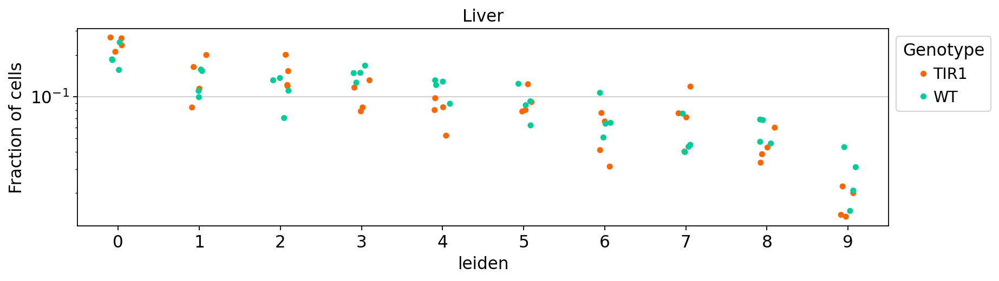

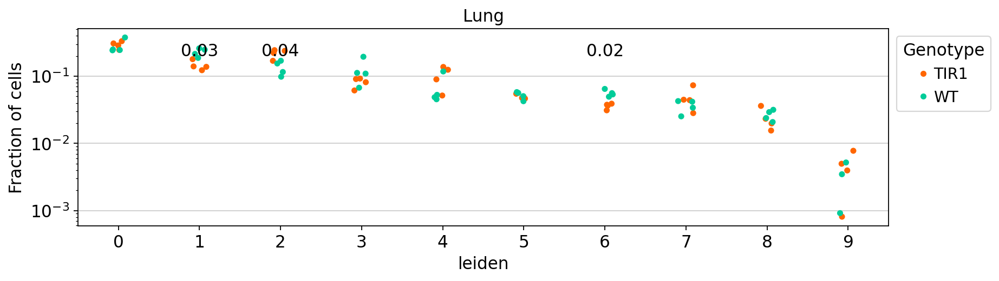

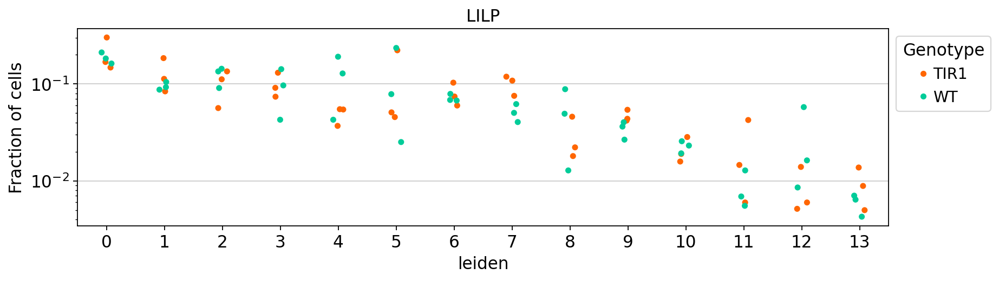

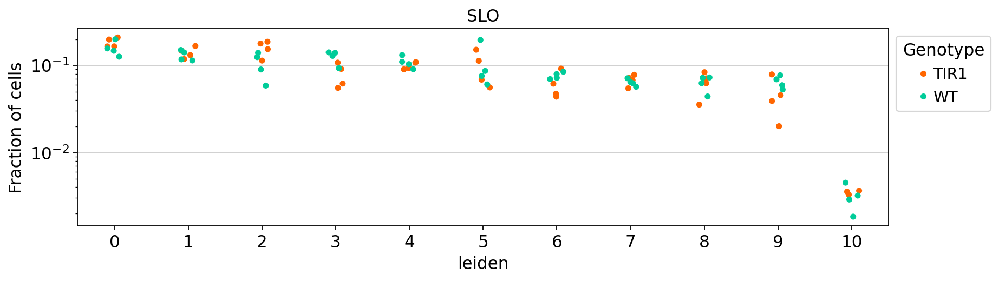

In [23]:
from revision_scrna_plots import leiden_cell_abundance_stripplots

figs = leiden_cell_abundance_stripplots(tissue_specific_adatas)
for fig in figs:
    fig.savefig(f'./final_plots/revision_plots/multi_organ_scrna/{tissue}_leiden_clustering.pdf', bbox_inches='tight')    

### Calculate Active/Resting Cells in Tissues

/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


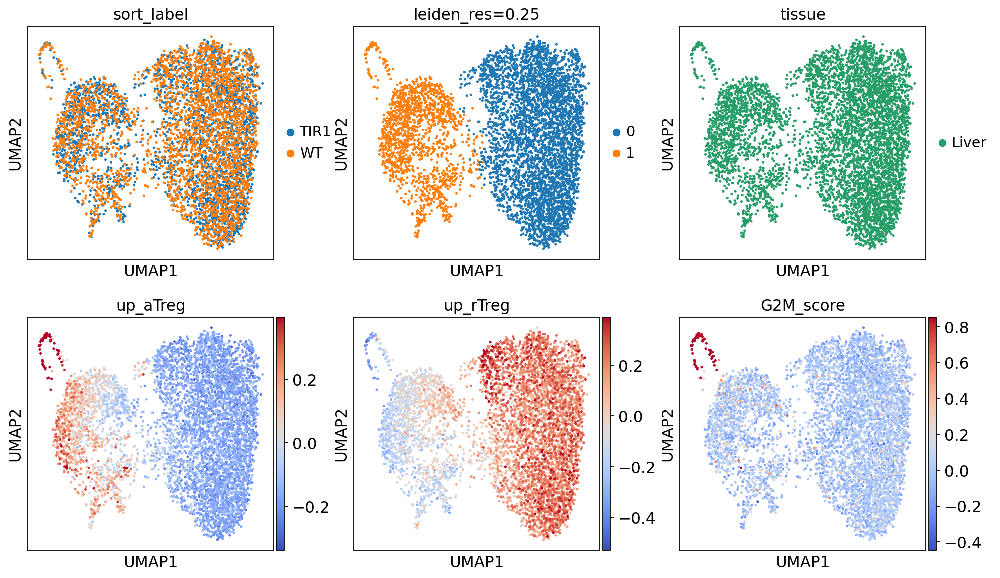

/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


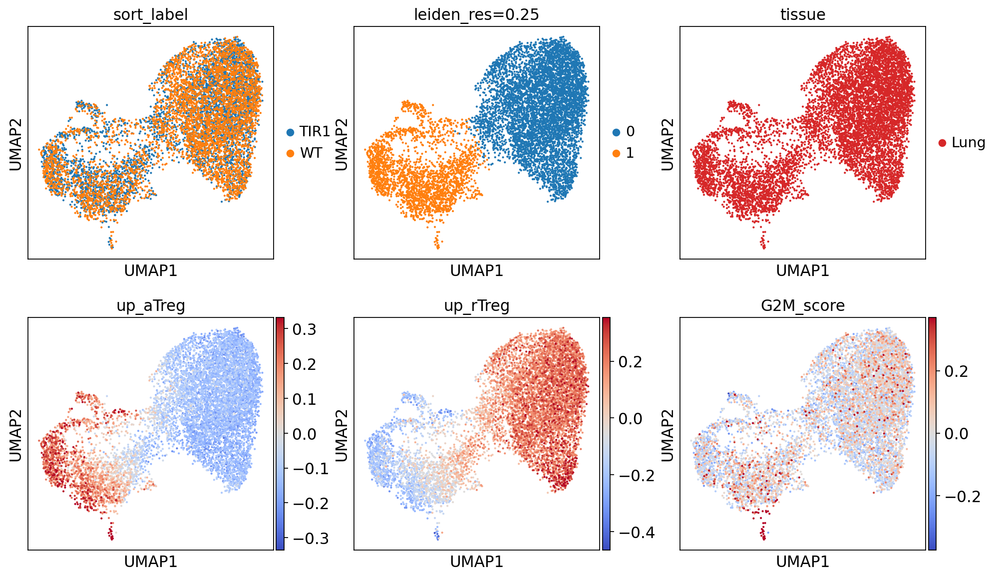

/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


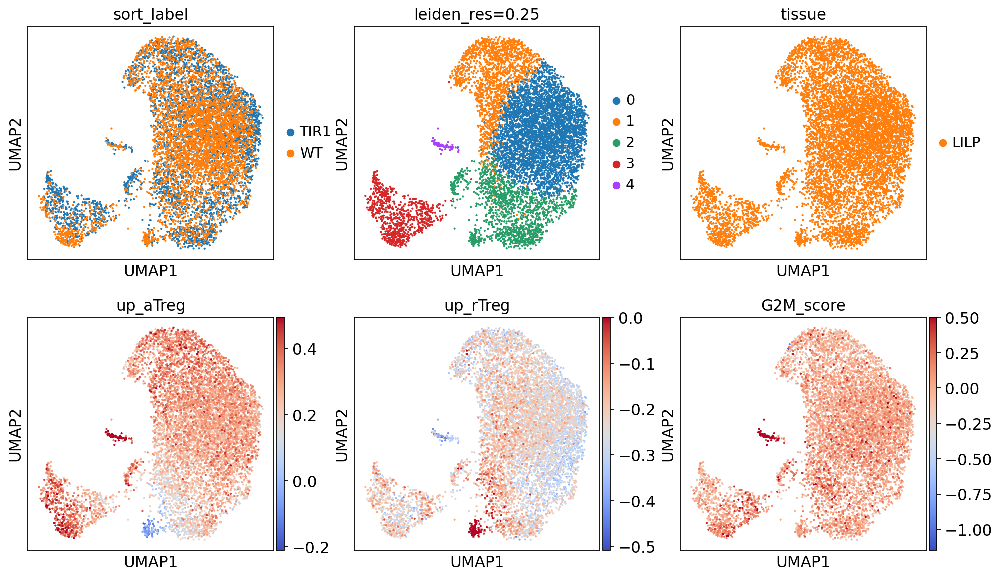

/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


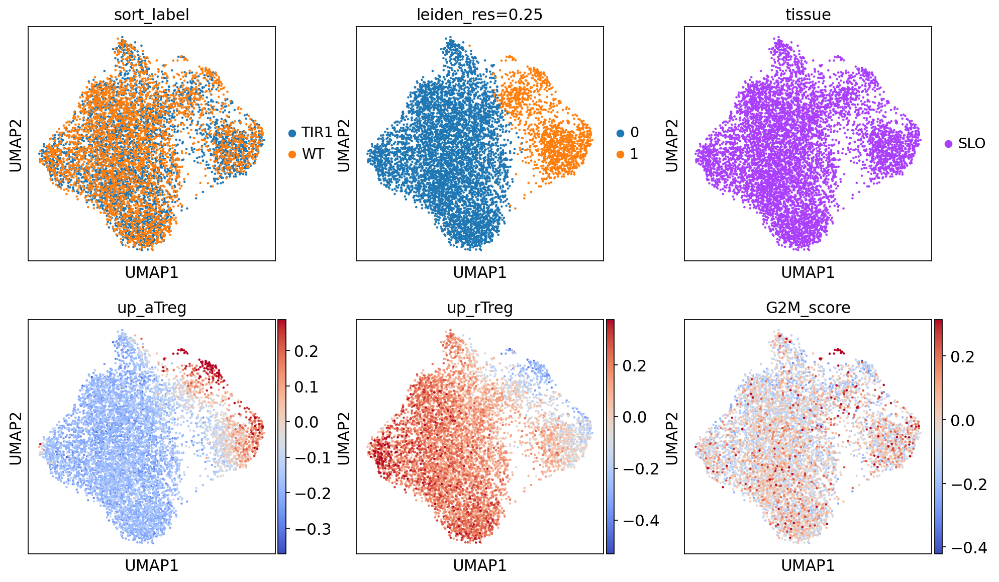

In [25]:
for tissue in tissue_specific_adatas:
    sc.pl.umap(tissue_specific_adatas[tissue], 
               color=['sort_label', 'leiden_res=0.25', 'tissue', 
                      'up_aTreg', 'up_rTreg', 'G2M_score'], cmap='coolwarm',
               ncols = 3,
               vmax='p99')

### Liver

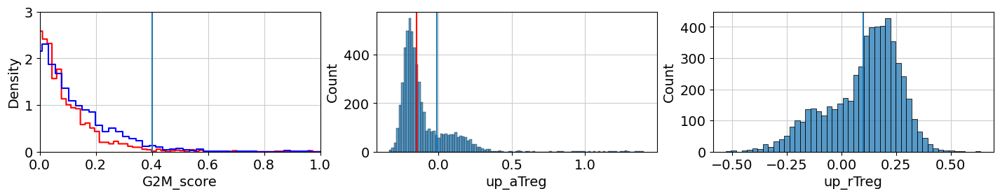

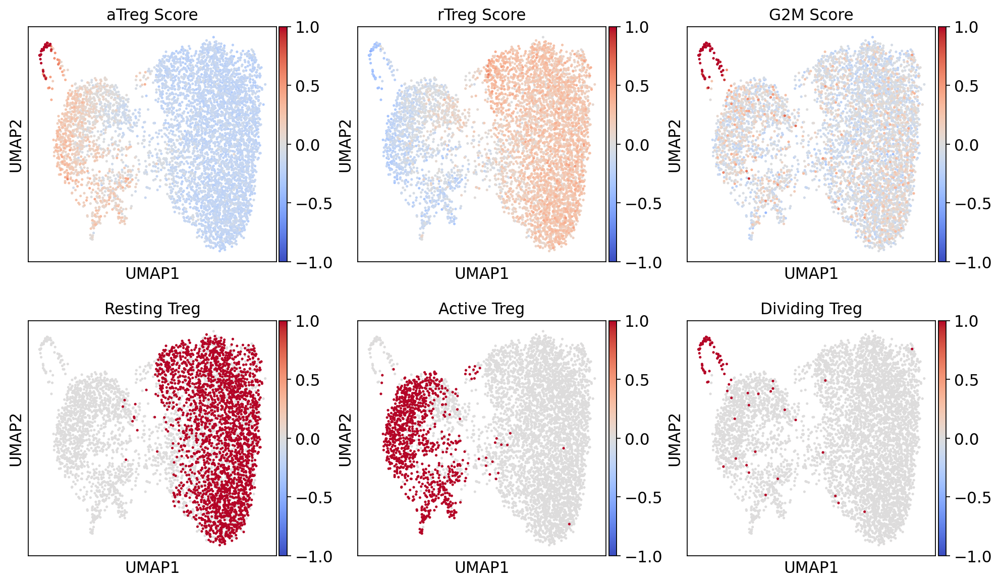

In [26]:
from plotting_functions import init_subplots_exact
from revisions_active_resting import make_active_resting_cutoffs

active_cutoff = -.01
resting_cutoff = .1
not_active_cutoff = -.15
dividing_cutoff = 0.4
fig = make_active_resting_cutoffs(dividing_cutoff, active_cutoff, resting_cutoff, not_active_cutoff, tissue_specific_adatas['Liver'])
fig.savefig('./final_plots/revision_plots/multi_organ_scrna/active_resting_liver.pdf', bbox_inches='tight')

### SLO

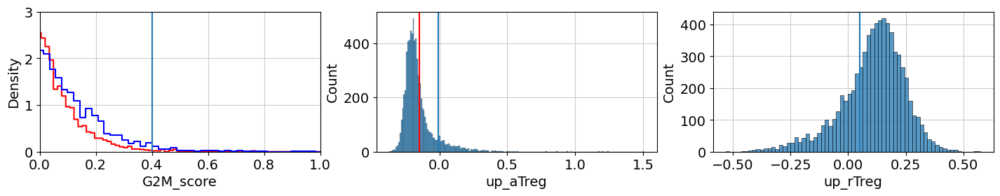

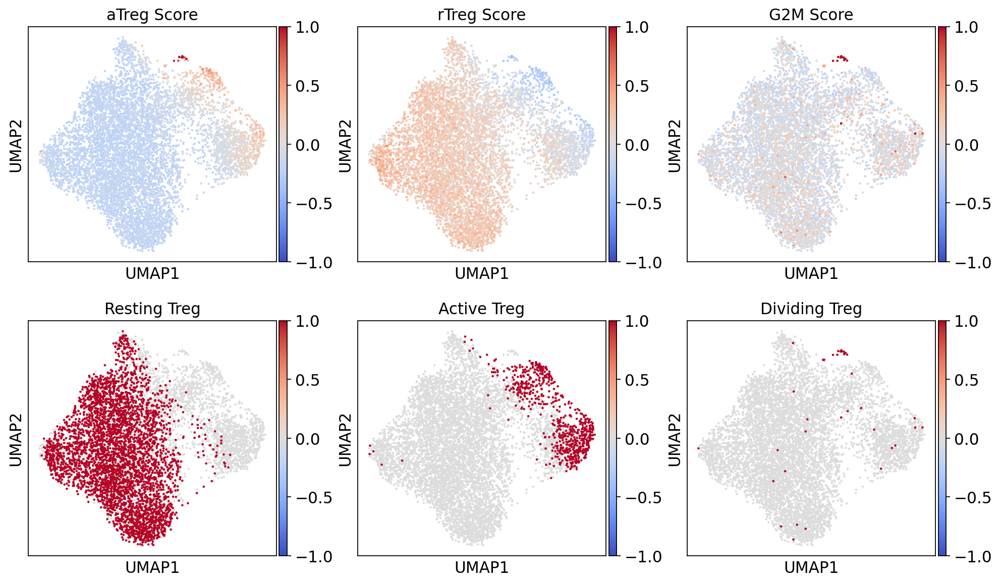

In [27]:
active_cutoff = -.01
resting_cutoff = 0.05
not_active_cutoff = -.15
dividing_cutoff = 0.4
fig = make_active_resting_cutoffs(dividing_cutoff, active_cutoff, resting_cutoff, not_active_cutoff, tissue_specific_adatas['SLO'])
fig.savefig('./final_plots/revision_plots/multi_organ_scrna/active_resting_SLO.pdf', bbox_inches='tight')

### Lung

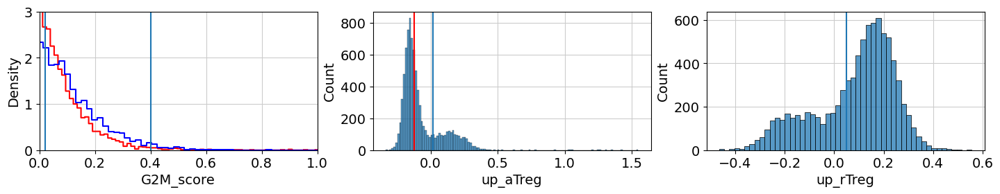

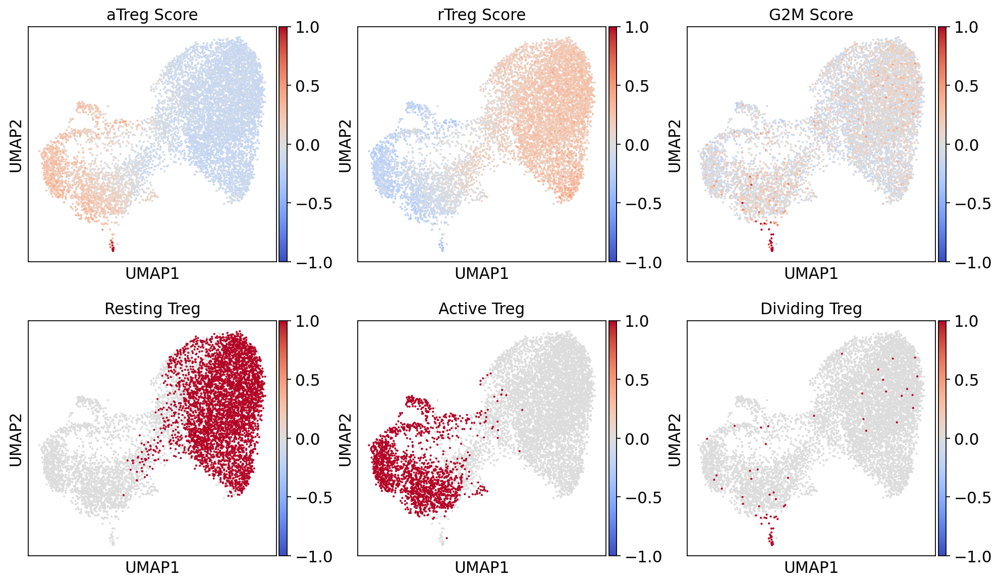

In [28]:
active_cutoff = .02
resting_cutoff = .05
not_active_cutoff = -.12
dividing_cutoff = 0.4
fig = make_active_resting_cutoffs(dividing_cutoff, active_cutoff, resting_cutoff, not_active_cutoff, tissue_specific_adatas['Lung'])
fig.savefig('./final_plots/revision_plots/multi_organ_scrna/active_resting_lung.pdf', bbox_inches='tight')

### LILP

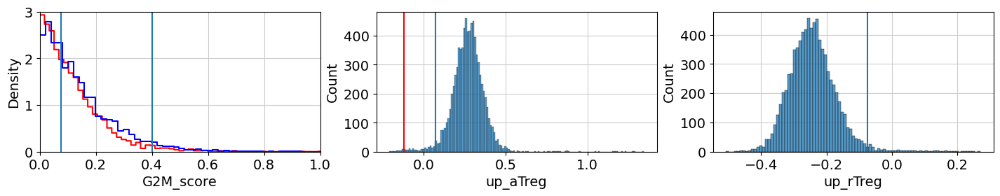

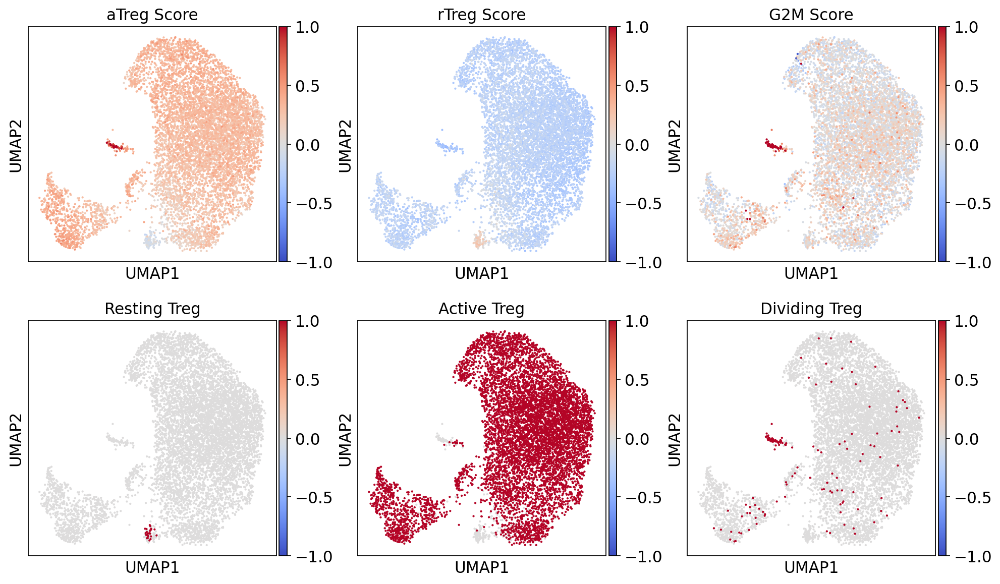

In [29]:
active_cutoff = .075
resting_cutoff = -.075
not_active_cutoff = -.12
dividing_cutoff = 0.4
fig = make_active_resting_cutoffs(dividing_cutoff, active_cutoff, resting_cutoff, not_active_cutoff, tissue_specific_adatas['LILP'])
fig.savefig('./final_plots/revision_plots/multi_organ_scrna/active_resting_LILP.pdf', bbox_inches='tight')

/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Genomics/argo/users/gdolsten/.conda/envs/ma

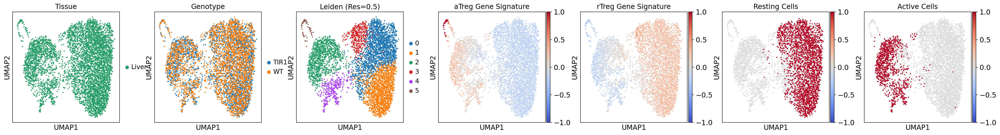

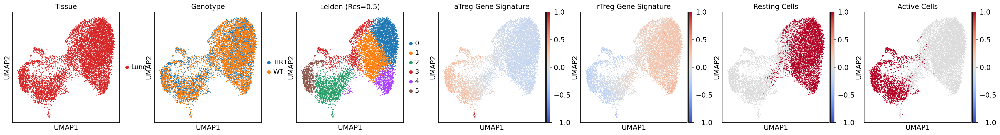

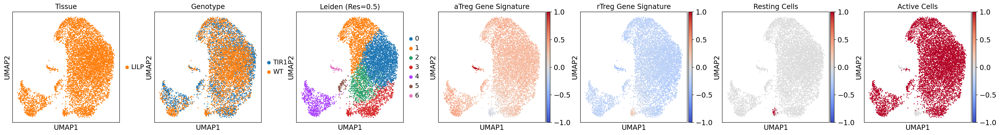

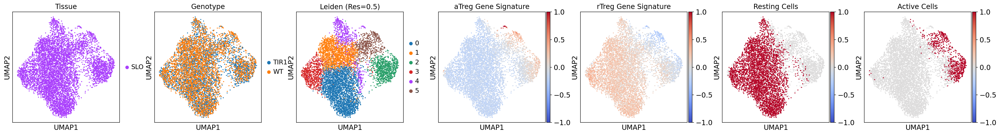

In [30]:
!mkdir -p final_plots/revision_plots/multi_organ_scrna/organ_umaps
for tissue in tissue_specific_adatas:
    fig = sc.pl.umap(tissue_specific_adatas[tissue], color=['tissue', 'sort_label', 'leiden_res=0.5', 'up_aTreg', 'up_rTreg', 'cell_is_resting', 'cell_is_active'],
                     cmap='coolwarm', vmax=1, vmin=-1,
                     title=['Tissue', 'Genotype', 'Leiden (Res=0.5)', 'aTreg Gene Signature', 
                            'rTreg Gene Signature', 'Resting Cells', 'Active Cells'],
                    return_fig=True, ncols = 7)
    fig.savefig(f'./final_plots/revision_plots/multi_organ_scrna/organ_umaps/{tissue}.pdf', bbox_inches = 'tight')

### Differential expression of the subsetted adatas

In [31]:
subset_adatas_for_deseq = {}
for tissue in tissue_specific_adatas:
    tiss_ad = tissue_specific_adatas[tissue]
    if tissue == 'LILP':
        subadata = tiss_ad
        subset_adatas_for_deseq[tissue] = subadata
    else:
        subadata = tiss_ad[tiss_ad.obs['cell_is_active'] > 0]
        subset_adatas_for_deseq[tissue + ': ' + "Active"] = subadata
        
        subadata = tiss_ad[tiss_ad.obs['cell_is_resting'] > 0]
        subset_adatas_for_deseq[tissue + ': ' + "Resting"] = subadata

        subadata = tiss_ad[tiss_ad.obs['cell_is_dividing'] > 0]
        subset_adatas_for_deseq[tissue + ': ' + "Dividing"] = subadata

In [32]:
subset_deseq_l2fc_df = pd.read_csv('./deseq2/multiorgan.lfc.tsv', sep='\t', index_col = 0)
subset_deseq_padj_df = pd.read_csv('./deseq2/multiorgan.padj.tsv', sep='\t', index_col = 0)

In [33]:
all_mean_counts_df = []
for tissue in subset_adatas_for_deseq:
    mean_counts_df = aggregate_adata_by_obs_column(subset_adatas_for_deseq[tissue], 'sample', 'counts', agg_func=np.mean).mean(axis=1)
    mean_counts_df.name = tissue
    all_mean_counts_df.append(mean_counts_df)
all_mean_counts_df = pd.concat(all_mean_counts_df, axis = 1)

In [34]:
degs = subset_deseq_padj_df.index[((subset_deseq_padj_df < .05) & (subset_deseq_l2fc_df.abs() > 0)
                                  ).any(axis=1)]
deg_lfc_df_organ = subset_deseq_l2fc_df.loc[degs]
deg_lfc_df_organ[all_mean_counts_df.loc[degs] < 2e-1] = np.nan
# o, clust, _ = make_order_and_cluster_custom(deg_lfc_df_organ.fillna(0), n_clusters=6)

In [35]:
deg_lfc_df_organ = deg_lfc_df_organ.loc[:, ~deg_lfc_df_organ.columns.str.contains("Dividing")]

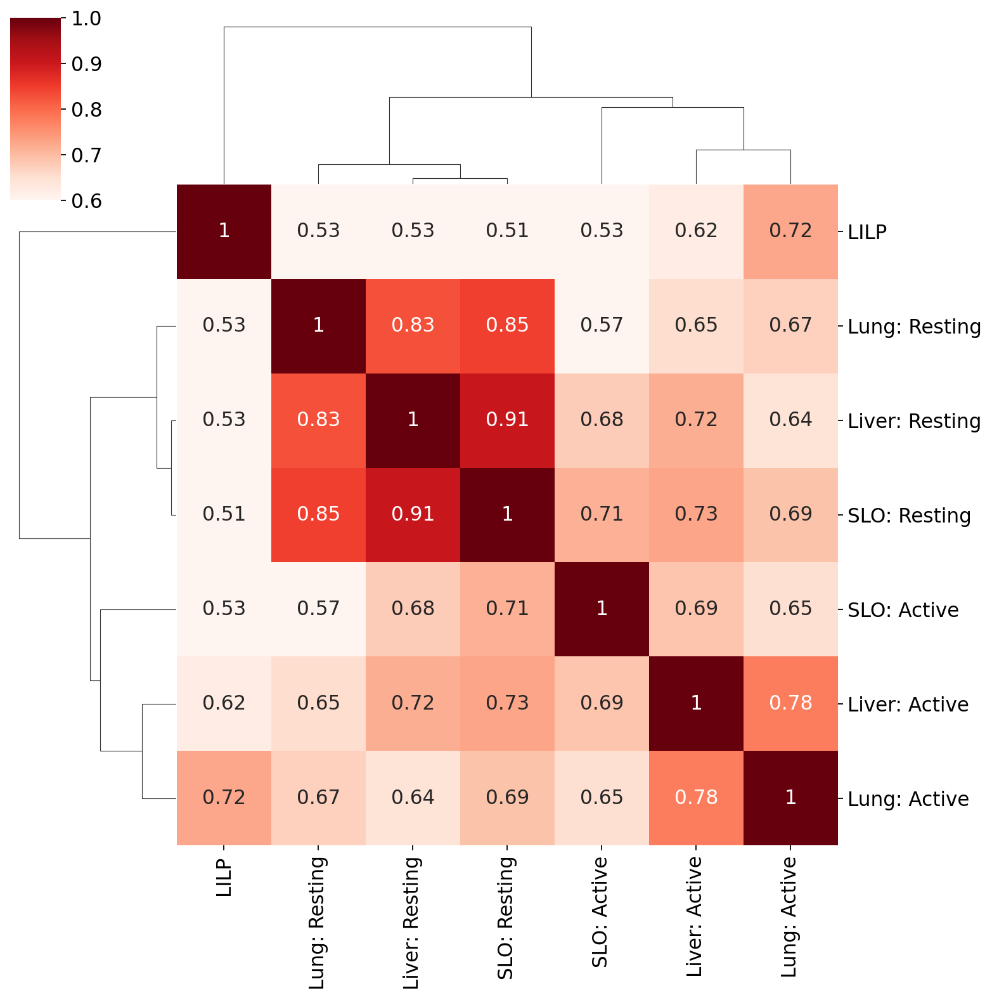

In [36]:
data = deg_lfc_df_organ.corr()
data.index.name = ''
data.columns.name = ''
g = sns.clustermap(data, yticklabels = True, cmap='Reds', #cbar_pos=None,
                   metric = 'cosine', vmin = .6, vmax=1, annot=True)
o = g.dendrogram_col.reordered_ind
column_order = data.columns[o]

g.savefig('./final_plots/revision_plots/multi_organ_scrna/sample_clustering.pdf', bbox_inches = 'tight')

In [37]:
o, clust, linkage = make_order_and_cluster_optimal(deg_lfc_df_organ.fillna(0), method='ward', metric='euclidean',
                                            n_clusters=5, return_linkage=True)

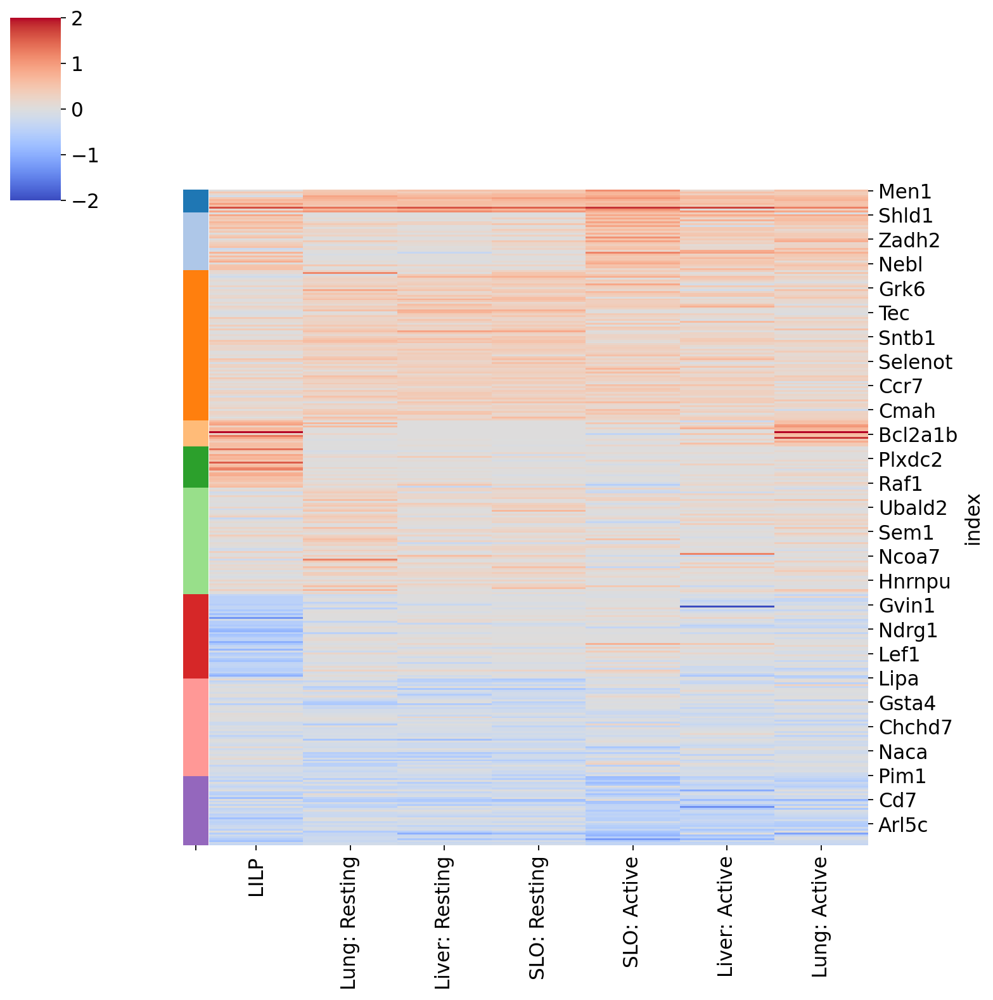

In [38]:
from revisions_KMeans_cluster import KMeans_Cluster

X = deg_lfc_df_organ.fillna(0).copy().clip(-1, 1)
order, row_colors, clustered_genes = KMeans_Cluster(X, n_clusters=9)

g = sns.clustermap(deg_lfc_df_organ.iloc[order][column_order].fillna(0), cmap='coolwarm', vmin=-2, vmax=2,
        row_colors = row_colors, col_cluster=False, row_cluster=False)

g.savefig('./final_plots/revision_plots/multi_organ_scrna/gene_heatmap.pdf', bbox_inches = 'tight')
clustered_genes.to_csv('./final_plots/revision_plots/multi_organ_scrna/dge_clustering.tsv', sep='\t')
g

/tmp/ipykernel_2941682/1220092934.py:9: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  tab20 = cm.get_cmap('tab20', 9)  # 9 colors (0 to 8)


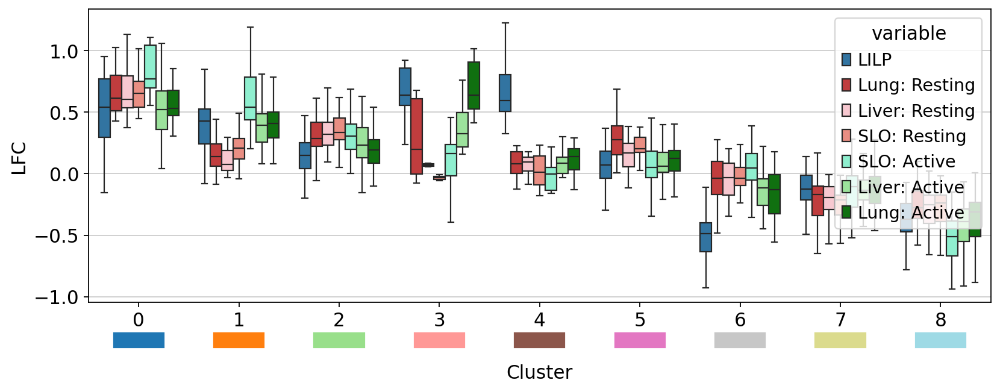

In [39]:
import matplotlib.patches as mpatches
import matplotlib.cm as cm

fig = plt.figure(figsize=(12, 4))
sns.boxplot(data=pd.concat([deg_lfc_df_organ, clustered_genes], axis=1).melt(0), x=0, hue='variable', y='value',
            hue_order = column_order,
           showfliers=False, palette = ['tab:blue', 'tab:red', 'pink', 'salmon', 'aquamarine', 'lightgreen', 'green'])
# Get tab20 colors
tab20 = cm.get_cmap('tab20', 9)  # 9 colors (0 to 8)

# Get axis and x positions
ax = plt.gca()
xticks = ax.get_xticks()

# Add a color patch under each xtick
ymin, ymax = ax.get_ylim()
y_patch = ymin - (ymax - ymin) * 0.05 - .25  # a bit below the plot
height = (ymax - ymin) * 0.05 

for i, x in enumerate(xticks):
    rect = mpatches.Rectangle(
        (x - 0.25, y_patch),  # x position: center it under the tick
        0.5,  # width
        height,
        color=tab20(i),
        clip_on=False
    )
    ax.add_patch(rect)

ax.set_xlabel("Cluster", labelpad=25)
plt.ylabel("LFC")

fig.savefig("./final_plots/revision_plots/multi_organ_scrna/cluster_boxplots.pdf", bbox_inches='tight')

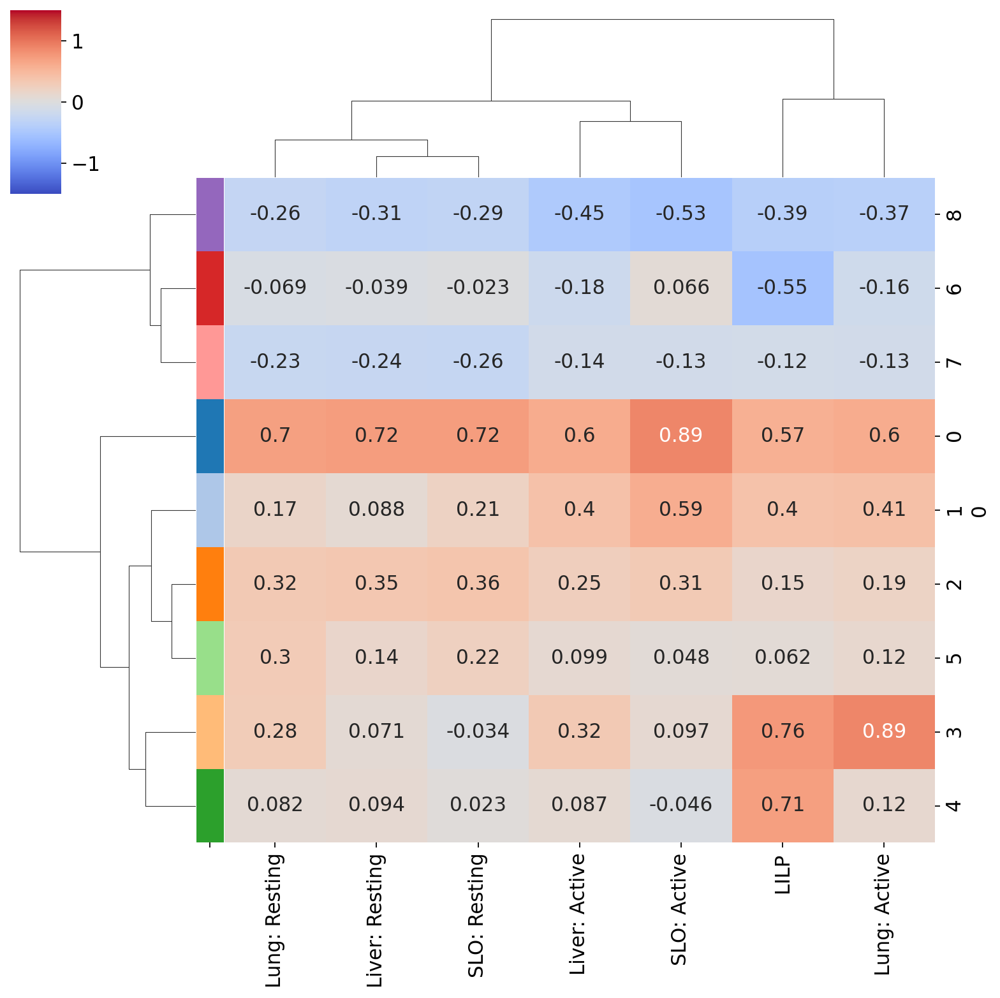

In [40]:
g = sns.clustermap(pd.concat([deg_lfc_df_organ, clustered_genes], axis=1).groupby(0).mean(),
                  row_colors = pd.Series(dict(zip(clustered_genes, row_colors.loc[clustered_genes.index]))),
                   cmap='coolwarm', vmin = -1.5, vmax = 1.5, method='ward',
                   annot=True
              )
g.savefig('./final_plots/revision_plots/multi_organ_scrna/lfc_by_cluster.pdf', bbox_inches='tight')

### Since LILP is almost entirely active cells, we subclustered LILP Tregs

/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


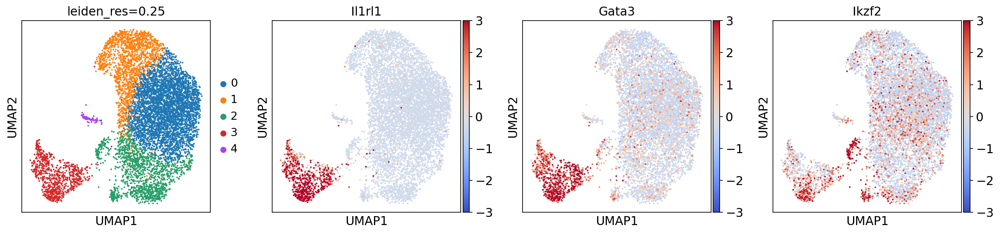

/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


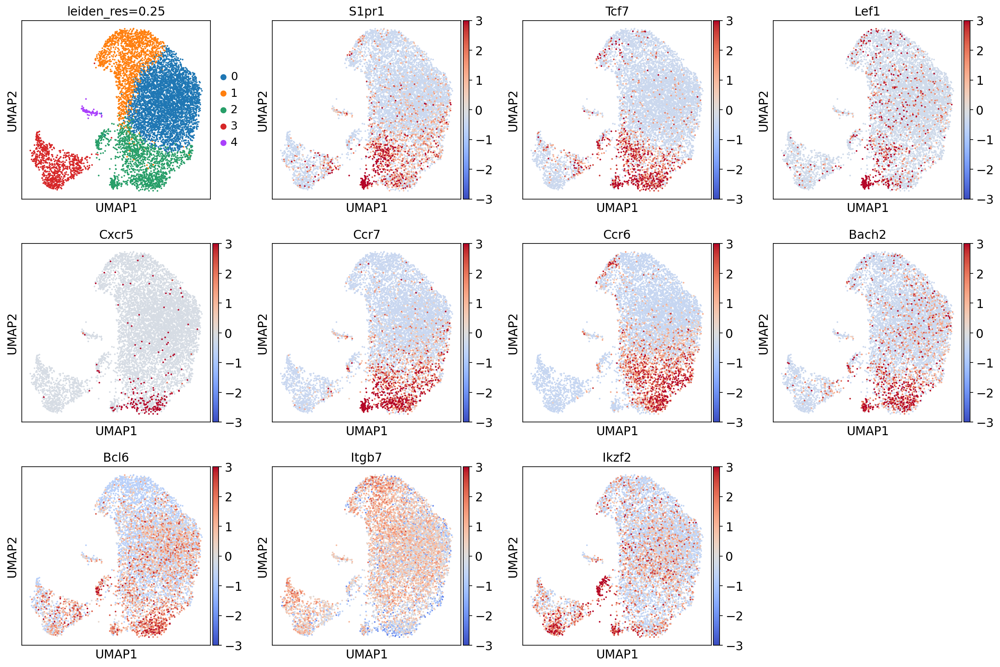

/Genomics/argo/users/gdolsten/.conda/envs/mamba/envs/scrna/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


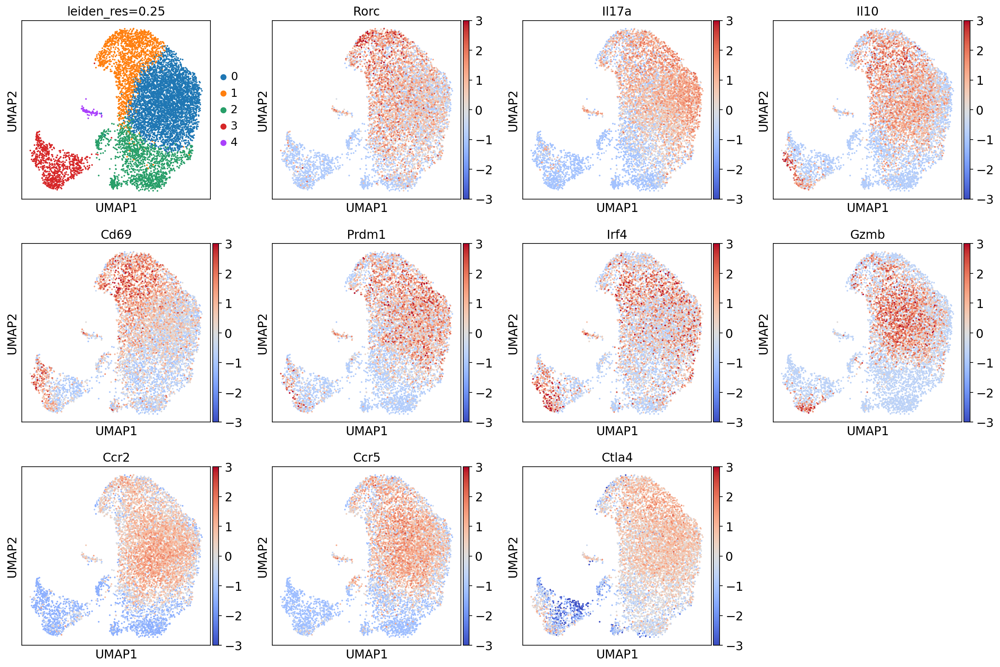

In [41]:
sc.pl.umap(tissue_specific_adatas['LILP'], color=['leiden_res=0.25', 'Il1rl1', 'Gata3', 'Ikzf2',
                                                 ], cmap='coolwarm', vmax=3, vmin=-3) # Leiden 3
sc.pl.umap(tissue_specific_adatas['LILP'], color=['leiden_res=0.25', 'S1pr1', 'Tcf7', 'Lef1', 'Cxcr5', 'Ccr7', 'Ccr6', 'Bach2', 
                                                  'Bcl6', 'Itgb7', 'Ikzf2',
                                                 ], cmap='coolwarm', vmax=3, vmin=-3) # Leiden 1
sc.pl.umap(tissue_specific_adatas['LILP'], color=['leiden_res=0.25',  'Rorc', 'Il17a', 'Il10', 'Cd69', 'Prdm1',  'Irf4',
                                                  'Gzmb', 'Ccr2', 'Ccr5',  'Ctla4',
                                                 ], cmap='coolwarm', vmax=3, vmin=-3)

In [42]:
LILP_clustering = {
    ('3') : 'ST2+ tTreg (Ikzf2+ Gata3+ Il1rl1+)', # pTreg
    ('2') : 'Lymphoid-Like tTreg (Ikzf2+ S1pr1+ Lef1+)', # 
    ('0', '1') : 'Colonic pTreg (RORC+ IL10+)',
    ('4') : 'Dividing'

}

# Convert the clustering dict to a flat mapping
flat_mapping = {}
for keys, name in LILP_clustering.items():
    if isinstance(keys, str):
        flat_mapping[keys] = name
    else:
        for key in keys:
            flat_mapping[key] = name

# Create the new column
tissue_specific_adatas['LILP'].obs['cluster_name'] = tissue_specific_adatas['LILP'].obs['leiden_res=0.25'].map(flat_mapping).fillna('Unknown')

n = tissue_specific_adatas['LILP'].obs.value_counts(['sample', 'cluster_name']).unstack().min().min()

LILP_cluster_adatas = {}
for leiden_tuple, name in LILP_clustering.items():
    LILP_cluster_adatas[name] = tissue_specific_adatas['LILP'][tissue_specific_adatas['LILP'].obs['leiden_res=0.25'].isin(list(leiden_tuple))]

In [43]:
name_to_short_name = {
    'ST2+ tTreg (Ikzf2+ Gata3+ Il1rl1+)' : 'ST2+ (NLT tTreg)',
    'Lymphoid-Like tTreg (Ikzf2+ S1pr1+ Lef1+)' : 'S1pr1+ (LT tTreg)',
    'Colonic pTreg (RORC+ IL10+)' : 'RORC+ (pTreg)',
    'Dividing' : 'Dividing',
}

In [44]:
LILP_subset_adatas_for_deseq = {}
tissue = 'LILP'
for cluster in LILP_cluster_adatas:
    if 'Div' in cluster:
        continue
        
    tiss_ad = LILP_cluster_adatas[cluster]
    subadata = tiss_ad[tiss_ad.obs['cluster_name']==cluster]
    LILP_subset_adatas_for_deseq[tissue + ': ' + cluster] = subadata

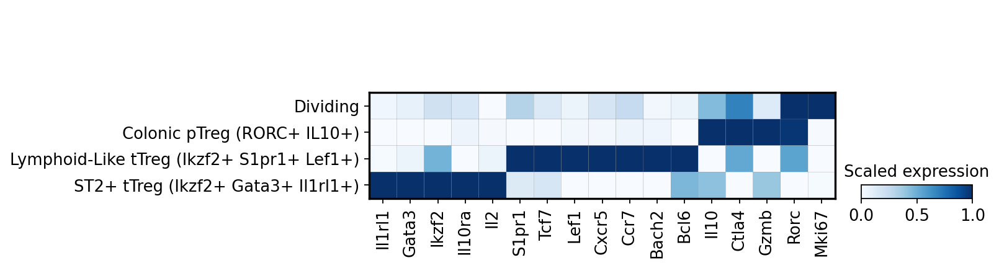

In [45]:
!mkdir -p final_plots/revision_plots/multi_organ_scrna/LILP_subclustering
fig = sc.pl.matrixplot(
    tissue_specific_adatas['LILP'],
    [
         'Il1rl1', 'Gata3', 'Ikzf2', 'Il10ra', 'Il2', # Cxcr3+
         'S1pr1', 'Tcf7', 'Lef1', 'Cxcr5', 'Ccr7', 'Bach2',  'Bcl6',  # 
         'Il10', 'Ctla4', 'Gzmb',
         'Rorc', 
         'Mki67'], # Th1-like
    "cluster_name",
    layer='log1p_norm',
    # dendrogram=True,
    cmap="Blues",
    standard_scale="var",
    colorbar_title="Scaled expression",
    categories_order = [ 'Dividing',  'Colonic pTreg (RORC+ IL10+)', 
                        'Lymphoid-Like tTreg (Ikzf2+ S1pr1+ Lef1+)',
                        'ST2+ tTreg (Ikzf2+ Gata3+ Il1rl1+)'],
    return_fig=True
)
fig.savefig('./final_plots/revision_plots/multi_organ_scrna/LILP_subclustering/matrix_gene_expr.pdf')
plt.show()

In [48]:
LILP_deseq_l2fc_df = pd.read_csv('deseq2/multiorganLILP.lfc.tsv', sep='\t', index_col = 0)
LILP_deseq_padj_df = pd.read_csv('deseq2/multiorganLILP.padj.tsv', sep='\t', index_col = 0)

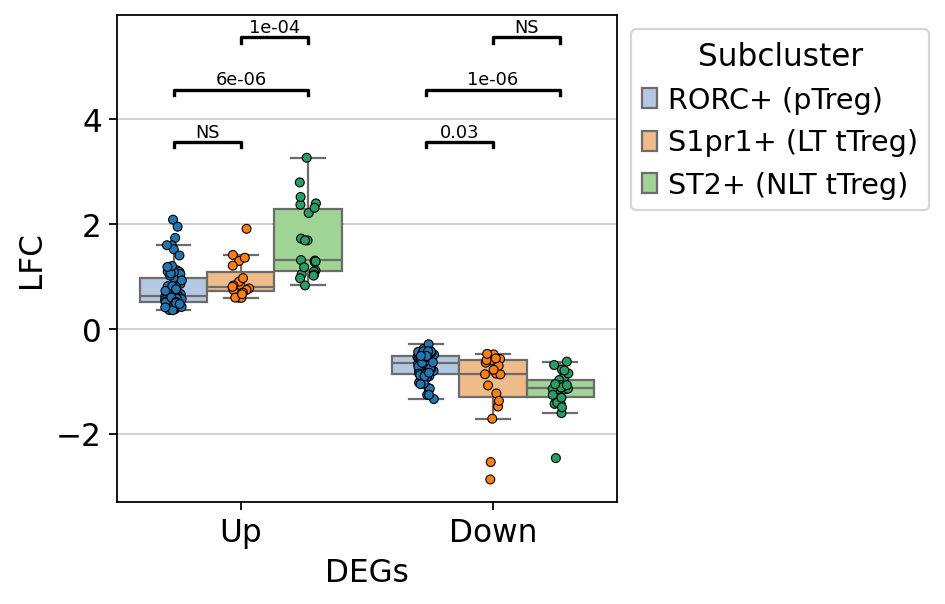

In [49]:
from itertools import combinations

datas = []
for col in LILP_deseq_l2fc_df:
    x = LILP_deseq_l2fc_df[LILP_deseq_padj_df[col] < .05][col]
    data_up = pd.DataFrame(x[x>0].values, columns=['LFC'])
    data_up['Cluster'] = col
    data_up['Direction'] = 'Up'
    data_down = pd.DataFrame(x[x<0].values, columns=['LFC'])
    data_down['Cluster'] = col
    data_down['Direction'] = 'Down'
    datas.extend([data_up, data_down])
datas = pd.concat(datas, axis=0)
sns.boxplot(data = datas, x='Direction', y='LFC', hue='Cluster', dodge=True, palette=[sns.color_palette('tab20')[1], 
                                                                                      sns.color_palette('tab20')[3], 
                                                                                      sns.color_palette('tab20')[5]],
           showfliers=False)

sns.stripplot(data = datas, x='Direction', y='LFC', hue='Cluster', dodge=True,
             edgecolor='black', linewidth = .5, s = 4, legend=False)
plt.xlabel("DEGs")
plt.legend(bbox_to_anchor=(1, 1), loc='upper left', title='Subcluster')

direction_order = datas['Direction'].unique()
cluster_order = datas['Cluster'].unique()

ax = plt.gca()

# Compute x positions (Direction index + dodge offset)


def add_bracket(ax, x1, x2, y, h, text):
    """
    Draw bracket between x1 and x2 at height y+h, with text above.
    """
    ax.plot([x1, x1, x2, x2], [y, y + h, y + h, y], lw=1.5, c='black')
    ax.text((x1 + x2) / 2, y + h + 0.02, text, ha='center', va='bottom', fontsize=8, color='black')

pos_dict = {}
n_clusters = len(cluster_order)
width = 0.8
dodge_width = width / n_clusters

for i_dir, direction in enumerate(direction_order):
    for i_clust, cluster in enumerate(cluster_order):
        x = i_dir - width/2 + dodge_width/2 + i_clust * dodge_width
        pos_dict[(direction, cluster)] = x

# Now compute tests and draw brackets
y_offset = datas['LFC'].max() + .2
bracket_height = 0.1

for direction, subdata in datas.groupby('Direction'):
    pairs = list(combinations(subdata['Cluster'].unique(), 2))
    for pair_idx, (c1, c2) in enumerate(pairs):
        x1 = pos_dict[(direction, c1)]
        x2 = pos_dict[(direction, c2)]
        
        lfc1 = subdata[subdata['Cluster'] == c1]['LFC']
        lfc2 = subdata[subdata['Cluster'] == c2]['LFC']
        
        if len(lfc1) > 1 and len(lfc2) > 1:
            tstat, pval = ttest_ind(lfc1, lfc2, equal_var=False)
            # if pval < 0.001:
            #     text = '***'
            # elif pval < 0.01:
            #     text = '**'
            # elif pval < 0.05:
            #     text = '*'
            # else:
            #     text = f"p={pval:.2g}"
            text = format_pvalue(pval)
            # print(pval)
            y = y_offset + pair_idx * 1
            add_bracket(ax, x1, x2, y, bracket_height, text)


plt.gcf().savefig('./final_plots/revision_plots/multi_organ_scrna/LILP_subclustering/DEG_LFCs.pdf', bbox_inches='tight')

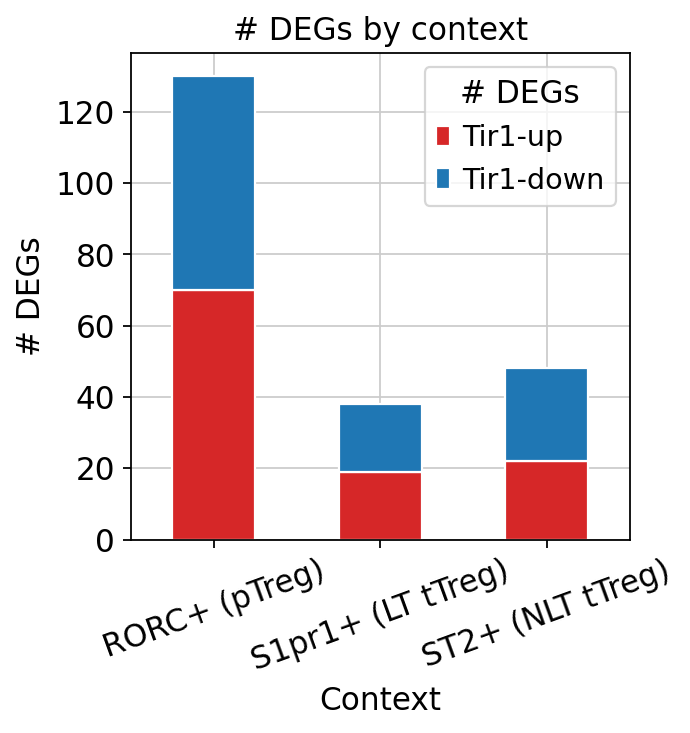

In [50]:
from revision_scrna_plots import n_deg_plot
# from update_scrna_plots import n_deg_plot

fig = n_deg_plot(LILP_deseq_padj_df, LILP_deseq_l2fc_df)
plt.xticks(rotation=20)
fig.savefig('./final_plots/revision_plots/multi_organ_scrna/LILP_subclustering/n_degs.pdf', bbox_inches='tight')

/Genomics/pritykinlab/gabe/jupys/tregs/rudensky_scrna/prelim-analysis/../../code/plotting_functions.py:1036: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'vmin', 'vmax' will be ignored
  c = ax.scatter(X, Y, **kwargs)
/Genomics/pritykinlab/gabe/jupys/tregs/rudensky_scrna/prelim-analysis/../../code/plotting_functions.py:1036: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'vmin', 'vmax' will be ignored
  c = ax.scatter(X, Y, **kwargs)
/Genomics/pritykinlab/gabe/jupys/tregs/rudensky_scrna/prelim-analysis/../../code/plotting_functions.py:1036: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'vmin', 'vmax' will be ignored
  c = ax.scatter(X, Y, **kwargs)


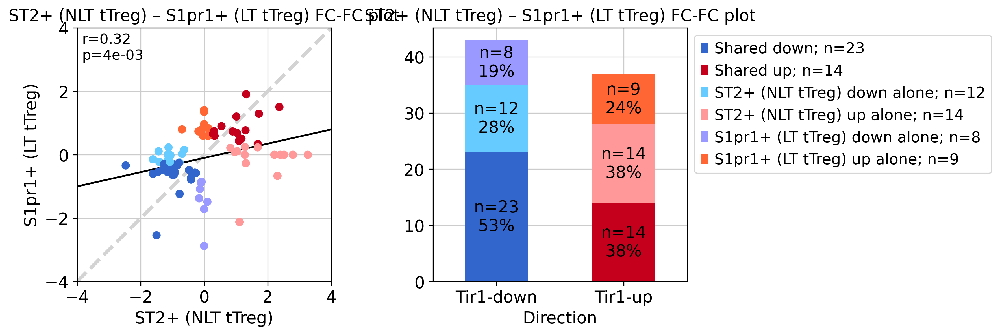

In [ ]:
from plotting_functions import *
from revision_fc_fc_plots import compute_deg_annotations_signed


deg_fractions = pd.DataFrame()
all_annotations = []
for tissue1, tissue2 in [
    ['ST2+ (NLT tTreg)', 'S1pr1+ (LT tTreg)'], 
    ['ST2+ (NLT tTreg)', 'RORC+ (pTreg)'], 
    ['S1pr1+ (LT tTreg)', 'RORC+ (pTreg)'],
                        ]:
    name1, name2 = tissue1, tissue2
    annotations2 = compute_deg_annotations_signed(
        LILP_deseq_l2fc_df,
        LILP_deseq_padj_df,
        tissue1 = tissue1,
        tissue2 = tissue2,
        lfc_agreement_cutoff = .25,
    ).dropna()
    
    degs = annotations2.index
    x, y = LILP_deseq_l2fc_df[tissue1][degs].copy(), LILP_deseq_l2fc_df[tissue2][degs].copy()
    x = x.fillna(0).clip(-3.9, 3.9)
    y = y.fillna(0).clip(-3.9, 3.9)
    og_annotations = annotations2['Label'].copy()
    c = og_annotations.copy()
    c[c=='Shared up'] = '#C5001D'
    c[c==f'Shared down'] = '#3366CC'
    c[c==f'{tissue1} up alone'] = '#FF9999'
    c[c==f'{tissue1} down alone'] = '#66CCFF'
    c[c==f'{tissue2} up alone'] = '#FF6633'
    c[c==f'{tissue2} down alone'] = '#9999FF'
    c[c=='Opposite'] = 'green'
    fig, axs = init_subplots_exact(2, 1, fgsz=(3, 3), xspace = 1.4, dpi = 150)
    plt.sca(axs[0])
    scatter_with_pearson(x, y, ax=axs[0], fontsize=12, cmap='coolwarm', c = c, zorder=3, vmin=-1, vmax=1,)
    for u in np.unique(c):
        n = np.sum(c==u)
        # plt.scatter([0], [0], c=[u], label=f'{color_to_labels[u]}; n={n}', cmap='coolwarm', vmin = -1, vmax = 1)
    # plt.legend(bbox_to_anchor=(1, 1))
    plt.xlabel(name1)
    plt.ylabel(name2)
    z = np.linspace(-4, 4)
    m, b = scipy.stats.linregress(x, y)[:2]
    plt.plot(z, z*m+b, color='black')
    plt.plot(z, z, color='lightgray', linestyle = '--', 
             linewidth = 3,
             zorder = 1)

    plt.xlim([-4, 4])
    plt.ylim([-4, 4])
    
    plt.sca(axs[1])
    import matplotlib.pyplot as plt
    from matplotlib.patches import Patch

    
    d_up = og_annotations[og_annotations.str.contains('up')].value_counts().reset_index()
    d_up['count'] = d_up['count']# / d_up['count'].sum()
    d_down = og_annotations[og_annotations.str.contains('down')].value_counts().reset_index()
    d_down['count'] = d_down['count']# / d_down['count'].sum()
    data = pd.concat([d_up, d_down])
    
    data['Direction'] = data['Label'].str.contains('up')
    data.loc[data['Direction']==True, 'Direction'] = 'Tir1-up'
    data.loc[data['Direction']==False, 'Direction'] = 'Tir1-down'
    
    label2color = pd.concat([c, og_annotations],axis=1)
    label2color.columns = ['Color', 'Label']
               
    label2color_dict = dict(zip(label2color['Label'], label2color['Color']))
    
    order = [
        'Shared down', 'Shared up',
        f'{tissue1} down alone', f'{tissue1} up alone', 
        f'{tissue2} down alone', f'{tissue2} up alone']
    
    # Pivot and plot
    pivot_df = data.pivot(index='Direction', columns='Label', values='count')[order]
    ax = pivot_df.plot.bar(
        stacked=True,
        color=[label2color_dict.get(x) for x in order],
        legend=False,
        ax=plt.gca()
    )
    
    # Clean up x-axis
    plt.xticks(rotation=0)
    
    # Create custom legend
    handles = [
        Patch(facecolor=label2color_dict[label], label=f"{label}; n={data.set_index('Label').loc[label, 'count']}")
        for label in order
    ]
    plt.legend(handles=handles, bbox_to_anchor=(1, 1))
    
    for container in ax.containers:
        labels = []
        for bar in container:
            height = bar.get_height()
            if 'up' in container.get_label():
                total_height = pivot_df.T.sum()['Tir1-up']
            else:
                total_height = pivot_df.T.sum()['Tir1-down']
            if height > 0:
                labels.append(f'n={height:.0f}\n{height/total_height*100:.0f}%')
            else:
                labels.append('')
        ax.bar_label(container, labels=labels, label_type='center')
    
    for ax in axs:
        ax.set_title(f'{name1} – {name2} FC-FC plot')
    all_annotations.append(pd.Series(annotations2['Label'], name = f'{name1}_{name2}'))

    fig.savefig(f'./final_plots/revision_plots/multi_organ_scrna/LILP_subclustering/fc_fc_{tissue1}_{tissue2}.pdf', bbox_inches='tight')
all_annotations = pd.DataFrame(all_annotations).T